# Graph layouts

In [1]:
import os
import pandas as pd

os.chdir('/root/host_home/sc-luca-explore/')

import networkx as nx
from networkx.drawing.nx_agraph import graphviz_layout

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from utils.abundance import plot_degree_centrality, plot_degree_distribution_power_law

In [2]:
backup_dir = '/root/datos/maestria/netopaas/luca_explore/surgeries/'
atlas_dir = '/root/datos/maestria/netopaas/luca/data/atlas/'
# The atlas with only tumor primary tissues and uicc stage annotated
id_ = 'extended_tumor_hvg'
cell_type_key = 'cell_type_adjusted'
sample_key = 'sample'
dataset_key = 'dataset'
time = 'I-II_leidenwu_funcnames'
time_solo = time.split('_')[0]
time_suffix = 'early' if time_solo == 'I-II' else 'late'
aracne_dir = 'outputARACNE'

## Paint MI network

In [ ]:
from utils import abundance

color_map = abundance.color_map
cell_categories = abundance.cell_categories
cell_type_to_category = abundance.cell_type_to_category

def cell_category_mapping(cell_type):
    return abundance.cell_category_mapping(cell_type)


### III-IV Leiden Wu

In [5]:
time = 'III-IV_leidenwu_funcnames'
G = nx.read_edgelist(f"{aracne_dir}/net{time}.txt", data=(("MI", float),('p', float)), delimiter='\t')

In [11]:
G.nodes(data=True)
node_colors = []
for node in G.nodes():
    category = cell_category_mapping(node)
    node_colors.append(color_map.get(category, 'gray'))

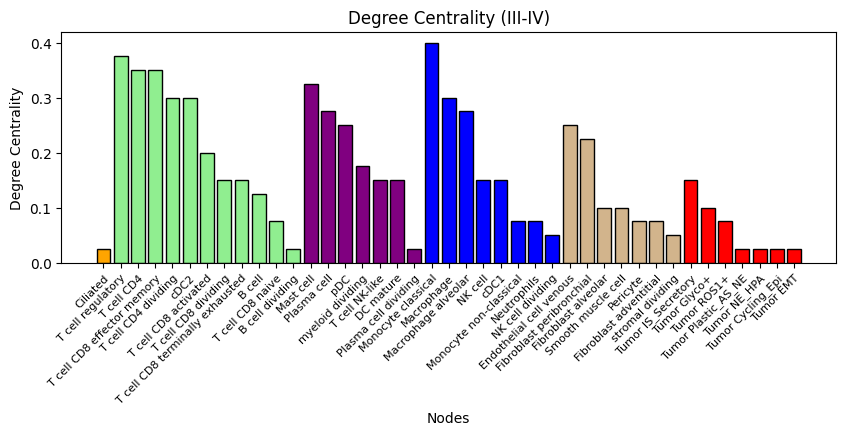

In [8]:
# Example usage
plot_degree_centrality(G)

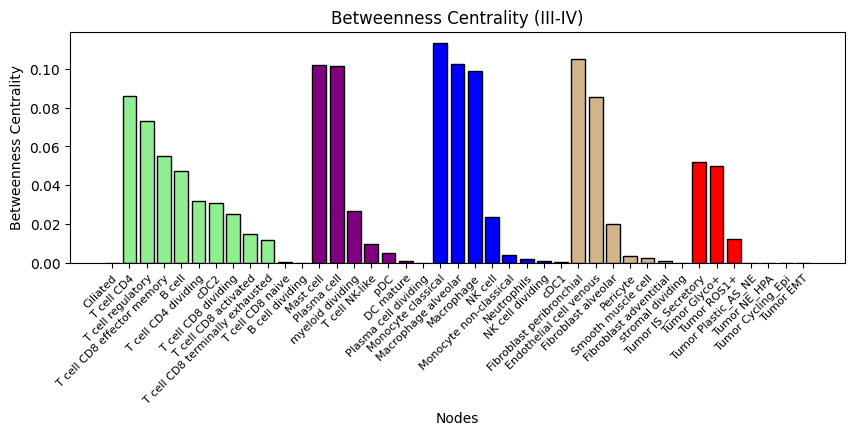

In [6]:
plot_degree_centrality(G, betweenness=True)

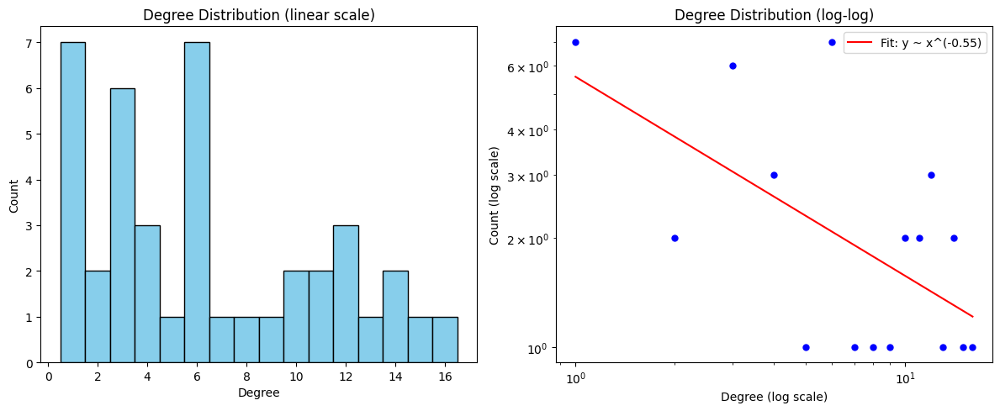

In [7]:
plot_degree_distribution_power_law(G)

#### Leiden Visualization

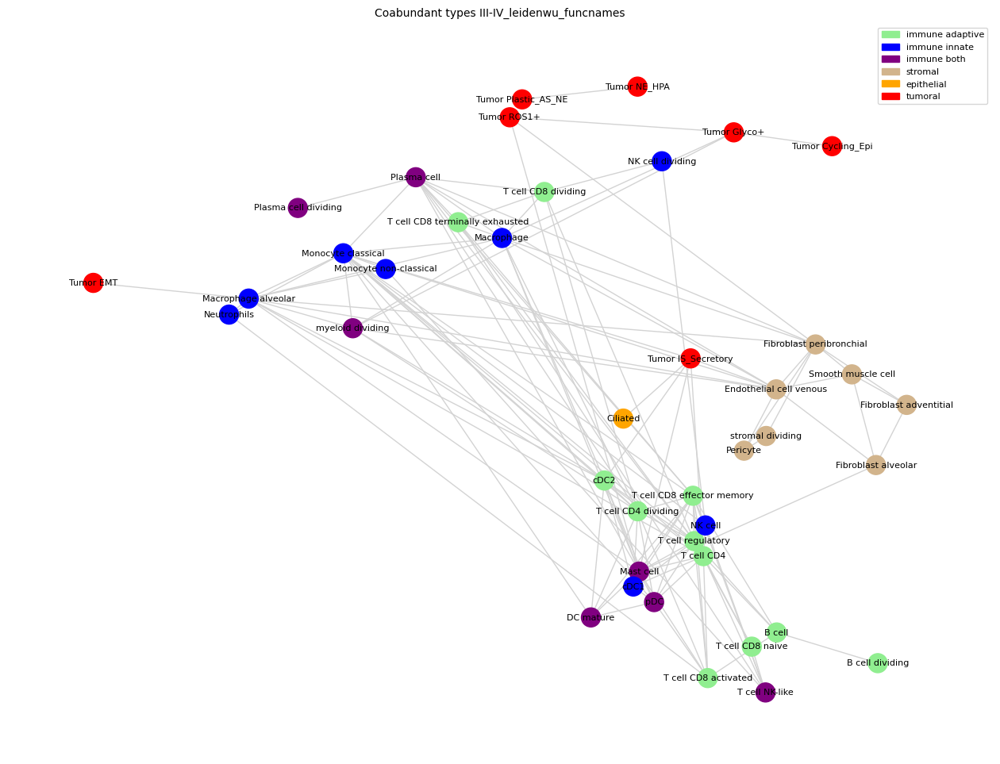

In [13]:
import igraph as ig
import leidenalg

# Assuming G is your NetworkX graph
G_ig = ig.Graph.Adjacency((nx.to_numpy_array(G) > 0).tolist())
G_ig.vs['name'] = list(G.nodes())

partition = leidenalg.find_partition(G_ig, leidenalg.ModularityVertexPartition, seed=0)
# partition = leidenalg.CPMVertexPartition(G_ig, resolution_parameter = 0.1)
# Get communities as a list of lists of node names
communities = [G_ig.vs[cluster]['name'] for cluster in partition]

# Map nodes to their community index
node_community = {}
for idx, community in enumerate(communities):
    for node in community:
        node_community[node] = idx

# Assign colors to nodes based on community
node_colors_comm = [node_community[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G, scale=30, seed=429)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=0, scale=4)
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

# nx.draw(
#     G, pos=pos, node_color=node_colors, node_size=300,
#     edge_color="lightgray", with_labels=True, font_size=8,
#     font_color="black",
# )
# plt.show()

nx.draw(G, pos=pos, node_color=node_colors, node_size=300,
            edge_color="lightgray", with_labels=True, font_size=8,
        font_color="black")
legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Newman centrality clustering

Newman es mas exacto para redes pequeñas

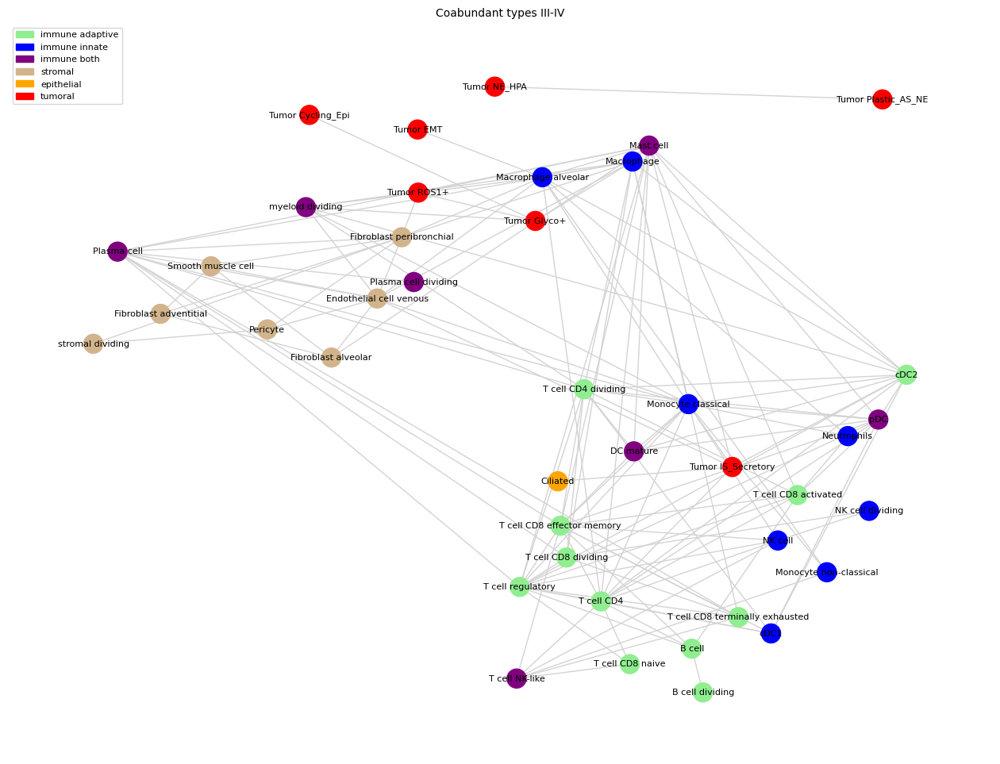

In [16]:
from networkx.algorithms.community import greedy_modularity_communities

# Perform Newman clustering
newman_communities = list(greedy_modularity_communities(G))

# Map nodes to their community index
node_community_newman = {}
for idx, community in enumerate(newman_communities):
   for node in community:
      node_community_newman[node] = idx

# Assign colors to nodes based on community
node_colors_newman = [node_community_newman[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time.split("_")[0]}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G,
   scale=30,  # SCAAAAAAAAAAAALE 1
   seed=1)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, newman_communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=1,
                               scale=4, k=3) # SCAAAAAAAAAAAALE 2
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

nx.draw(
    G, pos=pos, node_color=node_colors, node_size=300,
    edge_color="lightgray", with_labels=True, font_size=8,
    font_color="black",
)

legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

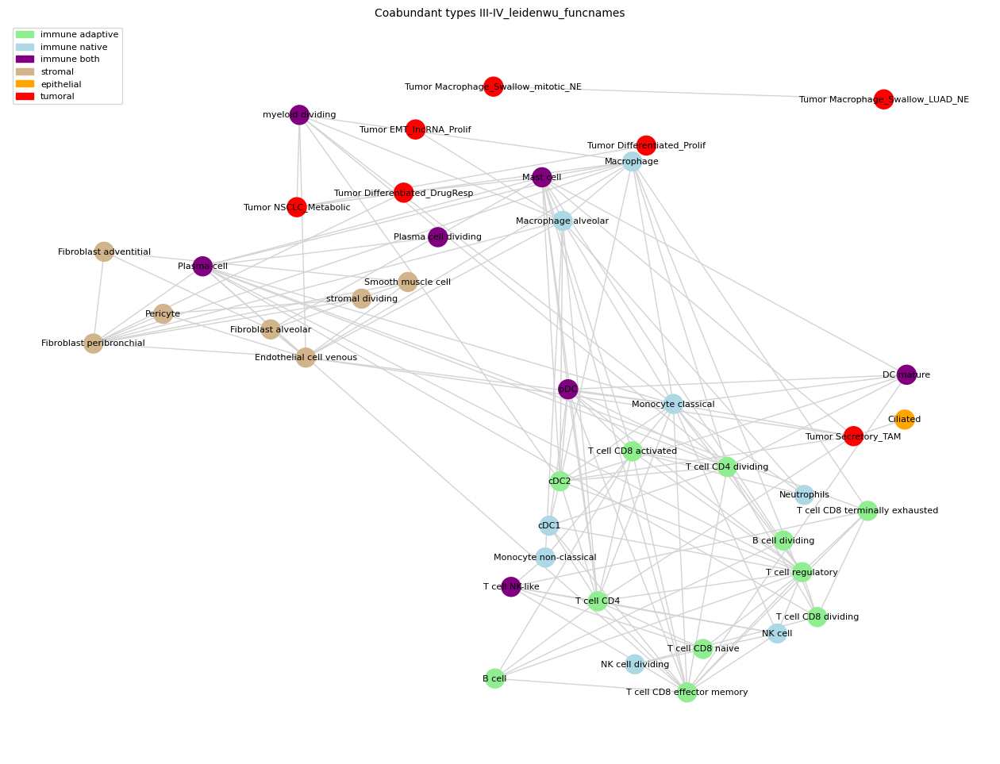

In [ ]:
from networkx.algorithms.community import greedy_modularity_communities

# Perform Newman clustering
newman_communities = list(greedy_modularity_communities(G))

# Map nodes to their community index
node_community_newman = {}
for idx, community in enumerate(newman_communities):
   for node in community:
      node_community_newman[node] = idx

# Assign colors to nodes based on community
node_colors_newman = [node_community_newman[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G,
   scale=30,  # SCAAAAAAAAAAAALE 1
   seed=1)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, newman_communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=1,
                               scale=4, k=3) # SCAAAAAAAAAAAALE 2
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

nx.draw(
    G, pos=pos, node_color=node_colors, node_size=300,
    edge_color="lightgray", with_labels=True, font_size=8,
    font_color="black",
)

legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Clique Percolation Visualization

En clique percolation vamos haciendo comunidades de n-cliques. Una n-clique es un grupo de nodos en donde los n
 están unidos entre si. Para hacer una comunidad debemos de tener varias n-cliques que tengan n-1 nodos en comun.
Esto nos garantiza que los nodos en esta comunidad estarán mas conectados entre si, que los que no están dentro.

Además, nuestras comunidades tendrán nodos en común pues solo estaremos buscando
 todas las posibles comunidades de cliques de tamaño n.

In [36]:
from matplotlib.patches import Wedge
import numpy as np
import matplotlib.colors as mcolors

def draw_pie(ax, ratios, X, Y, size, colors):
    start = 0
    for ratio, color in zip(ratios, colors):
        x, y = X, Y
        radius = size
        theta1 = start * 360
        theta2 = (start + ratio) * 360
        wedge = Wedge((x, y), radius, theta1, theta2, facecolor=color)
        ax.add_artist(wedge)
        start += ratio
    # Ensure the aspect ratio is equal to make the pie chart round
    # This messes with the figure size
    # ax.set_aspect('equal')

def regular_polygon_vertices(n, side_length=1):
    # Calculate the radius of the circumscribed circle
    radius = side_length / (2 * np.sin(np.pi / n))
    
    # Calculate the vertices
    vertices = []
    for i in range(n):
        angle = 2 * np.pi * i / n
        x = radius * np.cos(angle)
        y = radius * np.sin(angle)
        vertices.append((x, y))
    
    return vertices

def draw_clique_graph(G, k_clique=2):
    communities = list(nx.algorithms.community.k_clique_communities(G, k_clique))

    # Convert sets to lists for easier handling
    communities = [list(c) for c in communities]
    print(f"Found {len(communities)} communities. Appending the rest")
    communities.append(list(set(G.nodes()) - set([x for xs in communities for x in xs])))

    # Map each node to the communities it belongs to
    node_communities = {node: [i for i, community in enumerate(communities) if node in community]
                        for community in communities for node in community}

    # Get a list of colors with no community = gray
    colors = list(mcolors.TABLEAU_COLORS.keys())[:len(communities)]
    colors[len(communities)-1] = 'gray'
    # Get the centers of clusters depending on the number of communities
    n = len(communities)  # Number of sides
    vertices = regular_polygon_vertices(n, side_length=1.5)
    pos = {}
    for center, comm in zip(vertices, communities):
        subgraph = G.subgraph(comm)
        subpos = nx.spring_layout(subgraph, center=center, seed=2, k =1.5)
        pos.update(subpos)

    # Avoid label overlap (optional adjustment)
    pos_b = pos.copy()
    visited_pairs = set()
    for k, v in pos.items():
        for k2, v2 in pos.items():
            if k != k2 and (k, k2) not in visited_pairs and (k2, k) not in visited_pairs:
                if abs(v[0] - v2[0]) < 0.4 and abs(v[1] - v2[1]) < 0.2:
                    pos[k2] = (v2[0], v2[1] + 0.2)
                visited_pairs.add((k, k2))


    # Draw nodes with pie charts
    fig, ax = plt.subplots(figsize=(14, 8))

    # Draw edges
    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color='gray', ax=ax)

    for node in G.nodes():
        x, y = pos[node]
        community_indices = node_communities.get(node, [])
        ratios = [1 / len(community_indices)] * len(community_indices)
        node_colors = [colors[i] for i in community_indices]
        draw_pie(ax, ratios, x, y, 0.05, node_colors)

    # Draw labels (optional)
    nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)

    plt.title(f'Overlapping Communities with k={k_clique}')
    plt.axis('off')
    plt.show()

Tenemos 3 comunidades con 3 y 4-cliques, lo que habla de que no tenemos un solo grupo muy interconectado entre si. Como cuando juntamos las early y las late.
Las grises (osea las que no estan en una clqiue) son en su mayoria tumorales. Lo que puede ser por lo temprano de estado de cáncer, o nos recuerda la heterogeneidad
de los tejidos y que no se repiten mucho los fenotipos de cáncer.

Found 1 communities. Appending the rest


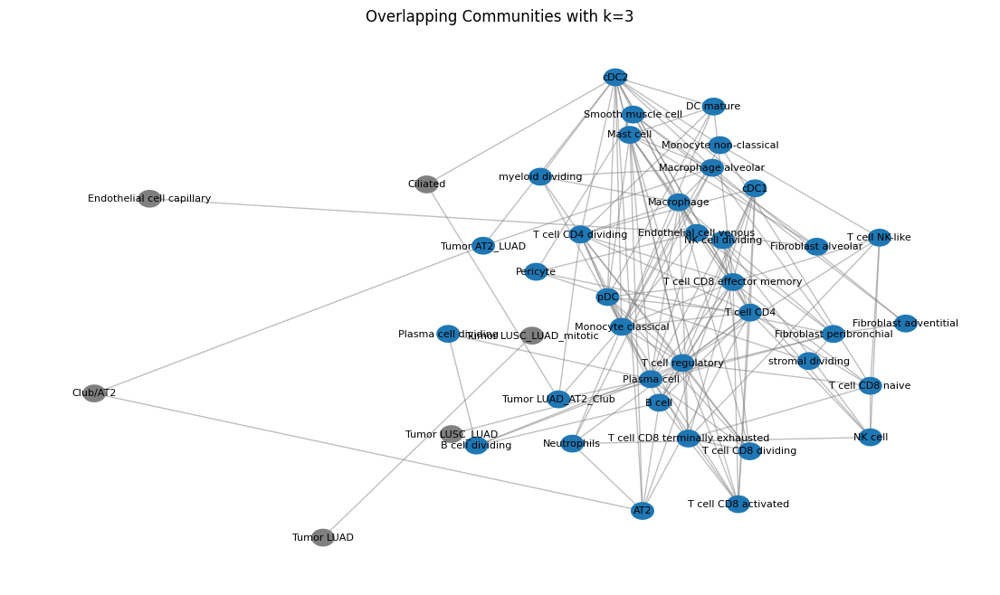

In [37]:
draw_clique_graph(G, k_clique=3)

Con 4-cliques tenemos tres comunidades, que se va a ir disminuyendo hasta que tengamos...

Found 2 communities. Appending the rest


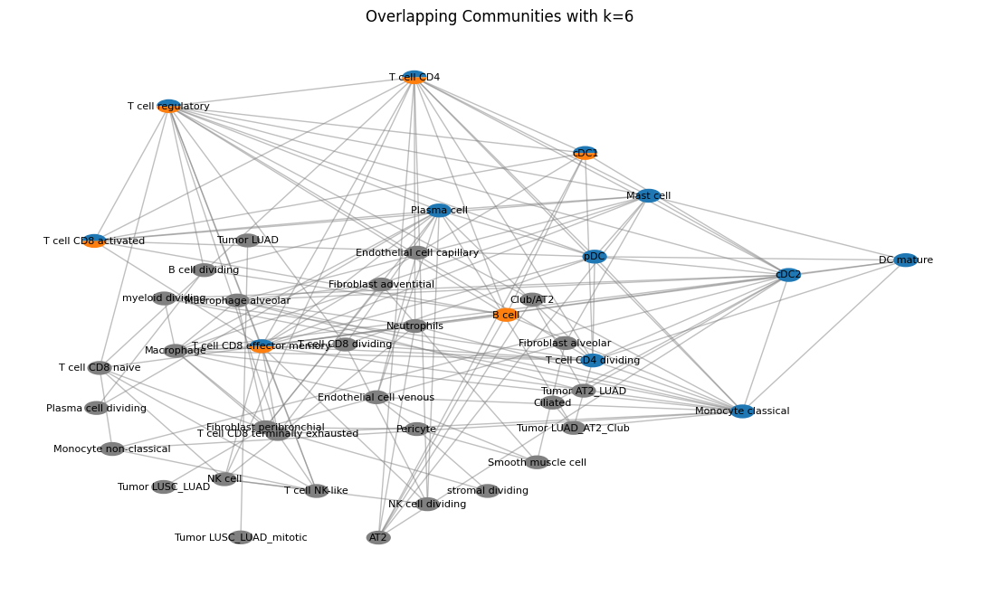

In [42]:
draw_clique_graph(G, k_clique=6)

Tenemos dos comunidades maximales. QUe estan compuestas por inmunes y fibrobalstos. Es curisos porque son el enfoque de dos de los estudios.

Found 1 communities. Appending the rest


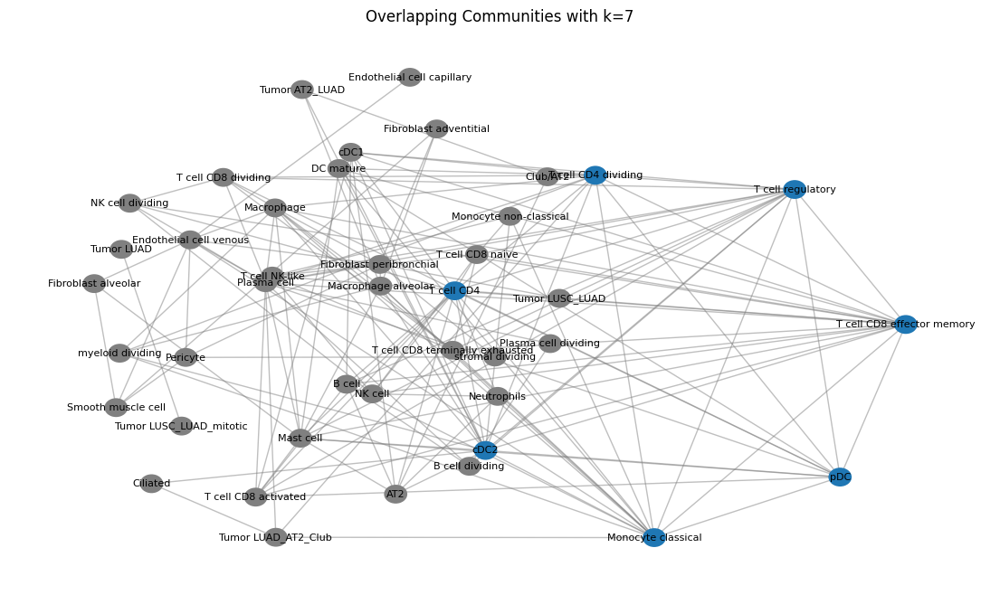

In [41]:
draw_clique_graph(G, k_clique=7)

#### Force bundle

/usr/local/lib/python3.11/site-packages/dask/dataframe/__init__.py:49: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
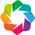

:HoloMap   [Bandwith]
   :Overlay
      .Graph.I     :Graph   [source,target]
      .Labels.I    :Labels   [x,y]   (name)
      .NdOverlay.I :NdOverlay   [Element]
         :Points   [x,y]

In [43]:
import matplotlib.pyplot as plt

from datashader.layout import forceatlas2_layout
from datashader.bundling import hammer_bundle
import holoviews as hv
hv.extension("bokeh") 

import matplotlib.colors as mcolors

color_mapper = mcolors.ListedColormap(list(color_map.values()))

# Extract nodes and edges from the graph G
cnodes = pd.DataFrame(G.nodes(), columns=['name'])
cnodes['cat'] = cnodes['name'].map(cell_type_to_category).astype('category')

# Create a mapping from node names to their row numbers in the cnodes DataFrame
node_to_index = {node: idx for idx, node in enumerate(cnodes['name'])}

# Replace node names in edges with their corresponding row numbers
cedges = pd.DataFrame([(node_to_index[source], node_to_index[target]) for source, target in G.edges()], columns=['source', 'target'])

# rd = random_layout(     cnodes, cedges)
fd = forceatlas2_layout(cnodes, cedges, seed=0)
nodes = hv.Nodes((fd['x'], fd['y'], fd.index, fd['name']), vdims='cat')

# Plot with larger nodes and labels
bd1 = 0.01
bd2 = 0.02
bd3 = 0.03
bd4 = 0.1

# Plot the graph with larger nodes and labels
graph = hv.HoloMap({bd1: hv.Graph((cedges, nodes, hammer_bundle(fd, cedges, initial_bandwidth=bd1))).opts(
    node_size=20, 
    node_color='cat',
    node_line_alpha=0.0,
    border=0,
    node_cmap=color_mapper,
    edge_color='gray', 
    xaxis=None, 
    yaxis=None,
    clabel=f'Force-directed, bundled {bd1}',)
      for bd1 in [bd1,
                   bd2, bd3, bd4
                   ]}, 'Bandwith')

# For colorbars
labels = hv.Labels(fd, ['x', 'y'], 'name').opts(text_font_size='8pt', text_align='center', text_color='black')
colorbar = hv.NdOverlay({cat: hv.Points([1,1]).opts(color=color, size=0) for cat, color in color_map.items()})

# Combine graph, labels, and colorbar
plot = (graph * labels * colorbar).opts(
    legend_position='top_right',
    width=800, 
    height=700,
)
hv.output(plot)

El force bundle parecía llamativo para poder identifcar mejor que célula interactua con que. 
Pero tiene el problema de que se unen caminos y pasan por nodos que ni estan conectados.
Para hace necesitamos ir cambiando la fuerza de conexion y ver como va pasando eso. De todos los dejamos porque es interactiva
 y nos deja ver las conexiones con el mouse.

In [28]:
GI = G

### I-II Leiden Wu

In [17]:
time = 'I-II_leidenwu_funcnames'
G = nx.read_edgelist(f"{aracne_dir}/net{time}.txt", data=(("MI", float),('p', float)), delimiter='\t')

node_colors = []
for node in G.nodes():
    category = cell_category_mapping(node)
    node_colors.append(color_map.get(category, 'gray'))

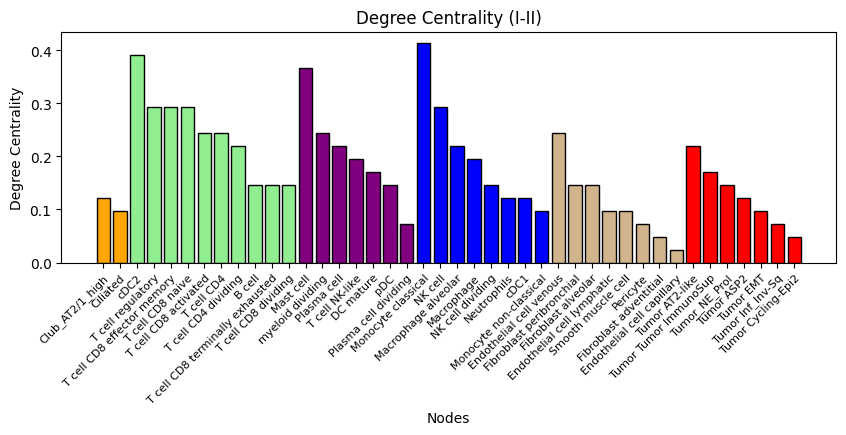

In [18]:
plot_degree_centrality(G, time=time_solo)

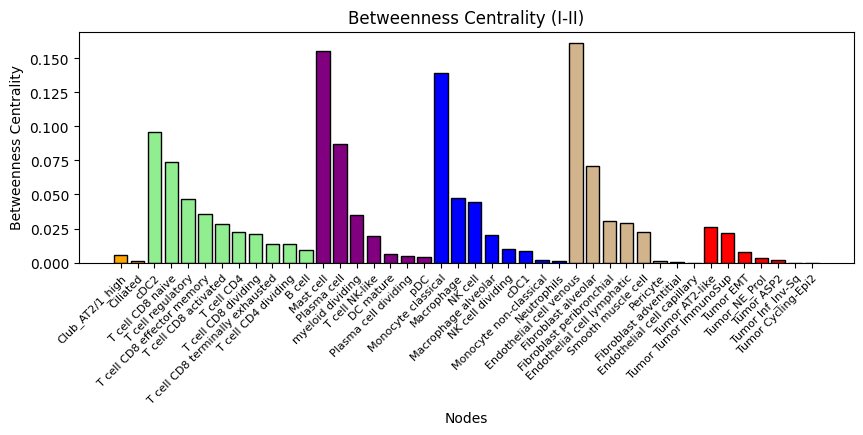

In [19]:
plot_degree_centrality(G, time=time_solo, betweenness=True)

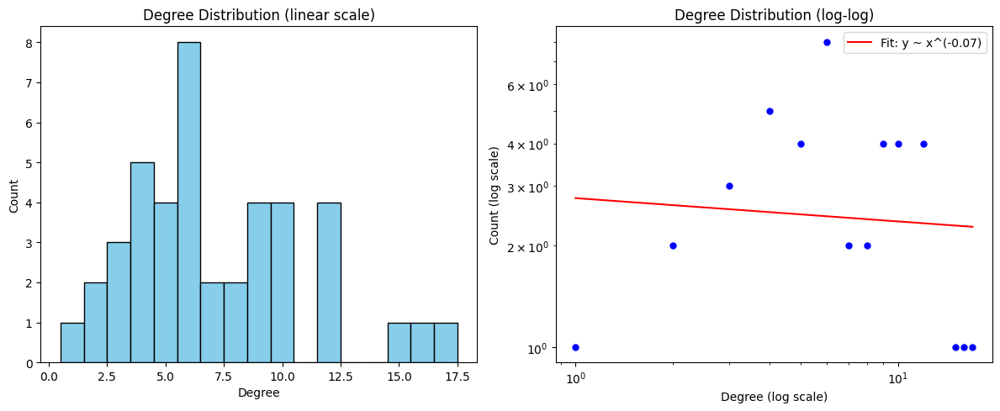

In [20]:
plot_degree_distribution_power_law(G)

#### Leiden Visualization

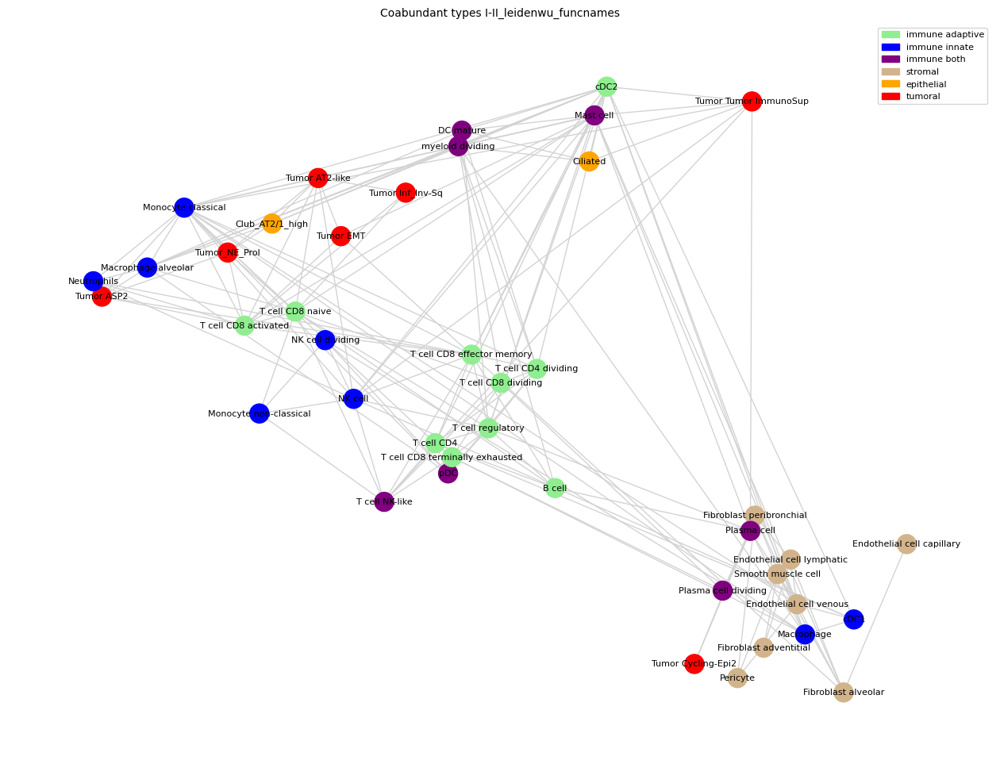

In [21]:
import igraph as ig
import leidenalg

# Assuming G is your NetworkX graph
G_ig = ig.Graph.Adjacency((nx.to_numpy_array(G) > 0).tolist())
G_ig.vs['name'] = list(G.nodes())

partition = leidenalg.find_partition(G_ig, leidenalg.ModularityVertexPartition, seed=0)
# partition = leidenalg.CPMVertexPartition(G_ig, resolution_parameter = 0.1)
# Get communities as a list of lists of node names
communities = [G_ig.vs[cluster]['name'] for cluster in partition]

# Map nodes to their community index
node_community = {}
for idx, community in enumerate(communities):
    for node in community:
        node_community[node] = idx

# Assign colors to nodes based on community
node_colors_comm = [node_community[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G, scale=30, seed=429)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=0, scale=4)
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

# nx.draw(
#     G, pos=pos, node_color=node_colors, node_size=300,
#     edge_color="lightgray", with_labels=True, font_size=8,
#     font_color="black",
# )
# plt.show()

nx.draw(G, pos=pos, node_color=node_colors, node_size=300,
            edge_color="lightgray", with_labels=True, font_size=8,
        font_color="black")
legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Newman centrality clustering

Newman es mas exacto para redes pequeñas

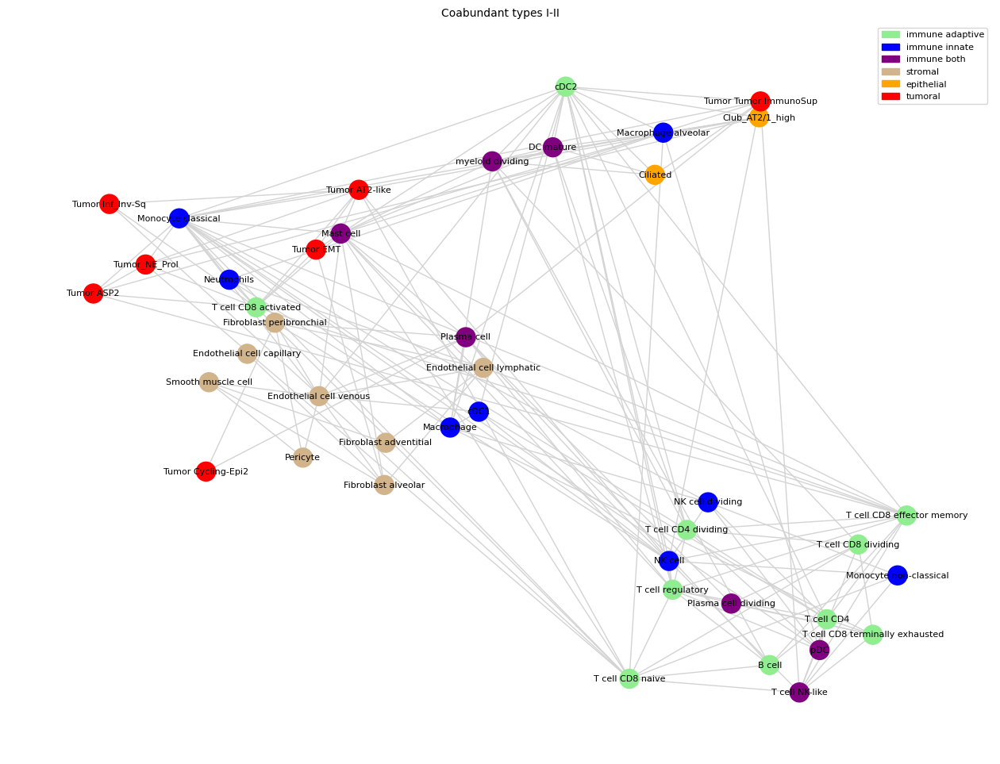

In [23]:
from networkx.algorithms.community import greedy_modularity_communities

# Perform Newman clustering
newman_communities = list(greedy_modularity_communities(G))

# Map nodes to their community index
node_community_newman = {}
for idx, community in enumerate(newman_communities):
   for node in community:
      node_community_newman[node] = idx

# Assign colors to nodes based on community
node_colors_newman = [node_community_newman[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time.split("_")[0]}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G,
   scale=30,  # SCAAAAAAAAAAAALE 1
   seed=1)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, newman_communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=1,
                               scale=4, k=3) # SCAAAAAAAAAAAALE 2
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

nx.draw(
    G, pos=pos, node_color=node_colors, node_size=300,
    edge_color="lightgray", with_labels=True, font_size=8,
    font_color="black",
)

legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Clique Percolation Visualization

En clique percolation vamos haciendo comunidades de n-cliques. Una n-clique es un grupo de nodos en donde los n
 están unidos entre si. Para hacer una comunidad debemos de tener varias n-cliques que tengan n-1 nodos en comun.
Esto nos garantiza que los nodos en esta comunidad estarán mas conectados entre si, que los que no están dentro.

Además, nuestras comunidades tendrán nodos en común pues solo estaremos buscando
 todas las posibles comunidades de cliques de tamaño n.

In [ ]:
from matplotlib.patches import Wedge
import numpy as np
import matplotlib.colors as mcolors

def draw_pie(ax, ratios, X, Y, size, colors):
    start = 0
    for ratio, color in zip(ratios, colors):
        x, y = X, Y
        radius = size
        theta1 = start * 360
        theta2 = (start + ratio) * 360
        wedge = Wedge((x, y), radius, theta1, theta2, facecolor=color)
        ax.add_artist(wedge)
        start += ratio
    # Ensure the aspect ratio is equal to make the pie chart round
    # This messes with the figure size
    # ax.set_aspect('equal')

def regular_polygon_vertices(n, side_length=1):
    # Calculate the radius of the circumscribed circle
    radius = side_length / (2 * np.sin(np.pi / n))
    
    # Calculate the vertices
    vertices = []
    for i in range(n):
        angle = 2 * np.pi * i / n
        x = radius * np.cos(angle)
        y = radius * np.sin(angle)
        vertices.append((x, y))
    
    return vertices

def draw_clique_graph(G, k_clique=2):
    communities = list(nx.algorithms.community.k_clique_communities(G, k_clique))

    # Convert sets to lists for easier handling
    communities = [list(c) for c in communities]
    print(f"Found {len(communities)} communities. Appending the rest")
    communities.append(list(set(G.nodes()) - set([x for xs in communities for x in xs])))

    # Map each node to the communities it belongs to
    node_communities = {node: [i for i, community in enumerate(communities) if node in community]
                        for community in communities for node in community}

    # Get a list of colors with no community = gray
    colors = list(mcolors.TABLEAU_COLORS.keys())[:len(communities)]
    colors[len(communities)-1] = 'gray'
    # Get the centers of clusters depending on the number of communities
    n = len(communities)  # Number of sides
    vertices = regular_polygon_vertices(n, side_length=1.5)
    pos = {}
    for center, comm in zip(vertices, communities):
        subgraph = G.subgraph(comm)
        subpos = nx.spring_layout(subgraph, center=center, seed=2, k =1.5)
        pos.update(subpos)

    # Avoid label overlap (optional adjustment)
    pos_b = pos.copy()
    visited_pairs = set()
    for k, v in pos.items():
        for k2, v2 in pos.items():
            if k != k2 and (k, k2) not in visited_pairs and (k2, k) not in visited_pairs:
                if abs(v[0] - v2[0]) < 0.4 and abs(v[1] - v2[1]) < 0.2:
                    pos[k2] = (v2[0], v2[1] + 0.2)
                visited_pairs.add((k, k2))


    # Draw nodes with pie charts
    fig, ax = plt.subplots(figsize=(14, 8))

    # Draw edges
    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color='gray', ax=ax)

    for node in G.nodes():
        x, y = pos[node]
        community_indices = node_communities.get(node, [])
        ratios = [1 / len(community_indices)] * len(community_indices)
        node_colors = [colors[i] for i in community_indices]
        draw_pie(ax, ratios, x, y, 0.05, node_colors)

    # Draw labels (optional)
    nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)

    plt.title(f'Overlapping Communities with k={k_clique}')
    plt.axis('off')
    plt.show()

Tenemos 3 comunidades con 3 y 4-cliques, lo que habla de que no tenemos un solo grupo muy interconectado entre si. Como cuando juntamos las early y las late.
Las grises (osea las que no estan en una clqiue) son en su mayoria tumorales. Lo que puede ser por lo temprano de estado de cáncer, o nos recuerda la heterogeneidad
de los tejidos y que no se repiten mucho los fenotipos de cáncer.

Found 1 communities. Appending the rest


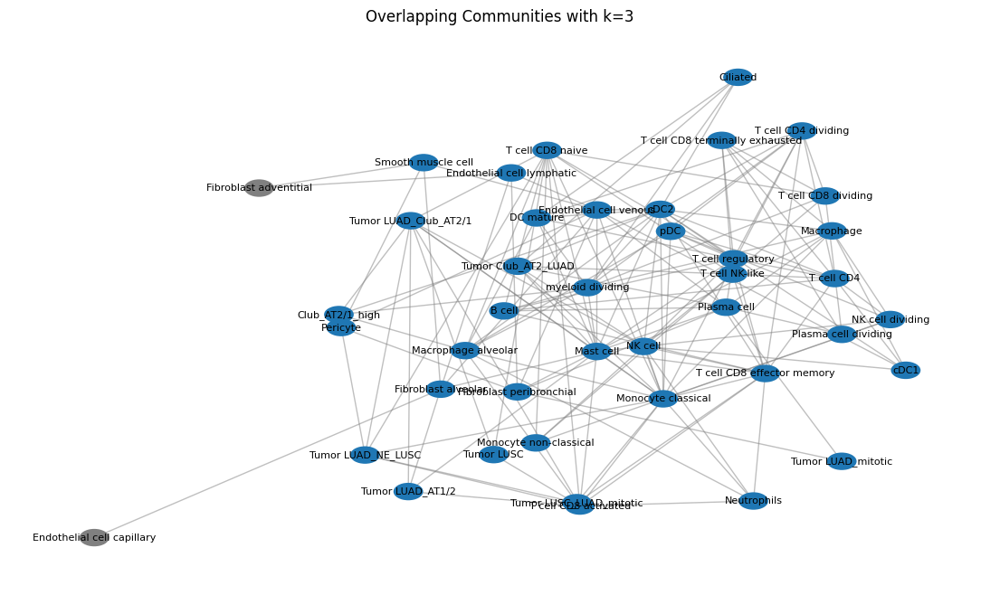

In [48]:
draw_clique_graph(G, k_clique=3)

Con 4-cliques tenemos tres comunidades, que se va a ir disminuyendo hasta que tengamos...

Found 1 communities. Appending the rest


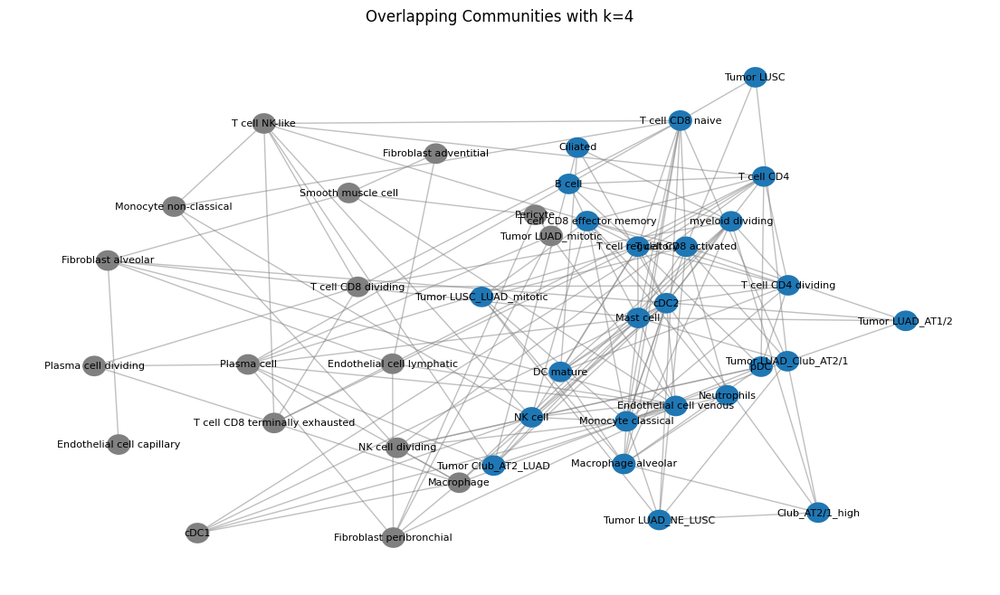

In [53]:
draw_clique_graph(G, k_clique=4)

Tenemos dos comunidades maximales. QUe estan compuestas por inmunes y fibrobalstos. Es curisos porque son el enfoque de dos de los estudios.

Found 3 communities. Appending the rest


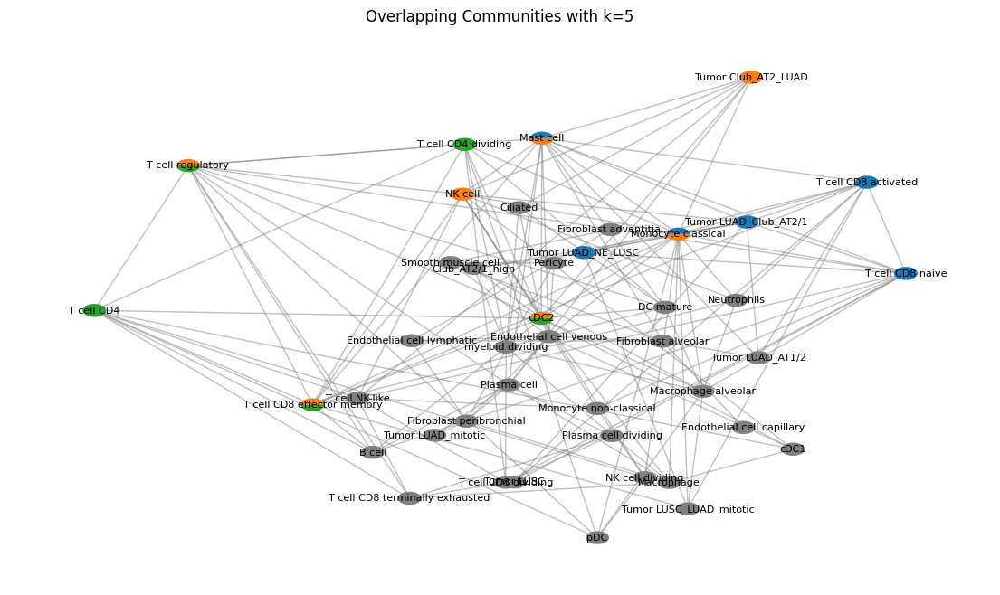

In [54]:
draw_clique_graph(G, k_clique=5)

### III-IV Leiden Separated

In [32]:
time = 'III-IV_leiden2'
G = nx.read_edgelist(f"{aracne_dir}/net{time}.txt", data=(("MI", float),('p', float)), delimiter='\t')

#### Leiden Visualization

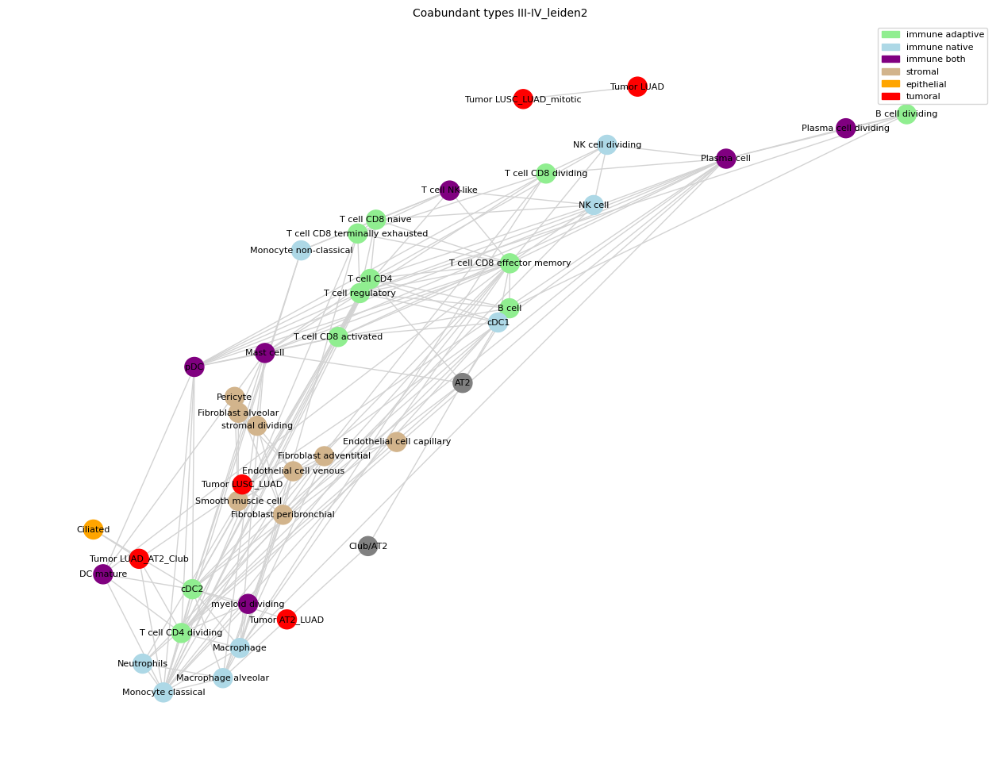

In [34]:
import igraph as ig
import leidenalg

# Assuming G is your NetworkX graph
G_ig = ig.Graph.Adjacency((nx.to_numpy_array(G) > 0).tolist())
G_ig.vs['name'] = list(G.nodes())

partition = leidenalg.find_partition(G_ig, leidenalg.ModularityVertexPartition, seed=0)
# partition = leidenalg.CPMVertexPartition(G_ig, resolution_parameter = 0.1)
# Get communities as a list of lists of node names
communities = [G_ig.vs[cluster]['name'] for cluster in partition]

# Map nodes to their community index
node_community = {}
for idx, community in enumerate(communities):
    for node in community:
        node_community[node] = idx

# Assign colors to nodes based on community
node_colors_comm = [node_community[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G, scale=30, seed=429)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=0, scale=4)
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

# nx.draw(
#     G, pos=pos, node_color=node_colors, node_size=300,
#     edge_color="lightgray", with_labels=True, font_size=8,
#     font_color="black",
# )
# plt.show()

nx.draw(G, pos=pos, node_color=node_colors, node_size=300,
            edge_color="lightgray", with_labels=True, font_size=8,
        font_color="black")
legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Newman centrality clustering

Newman es mas exacto para redes pequeñas

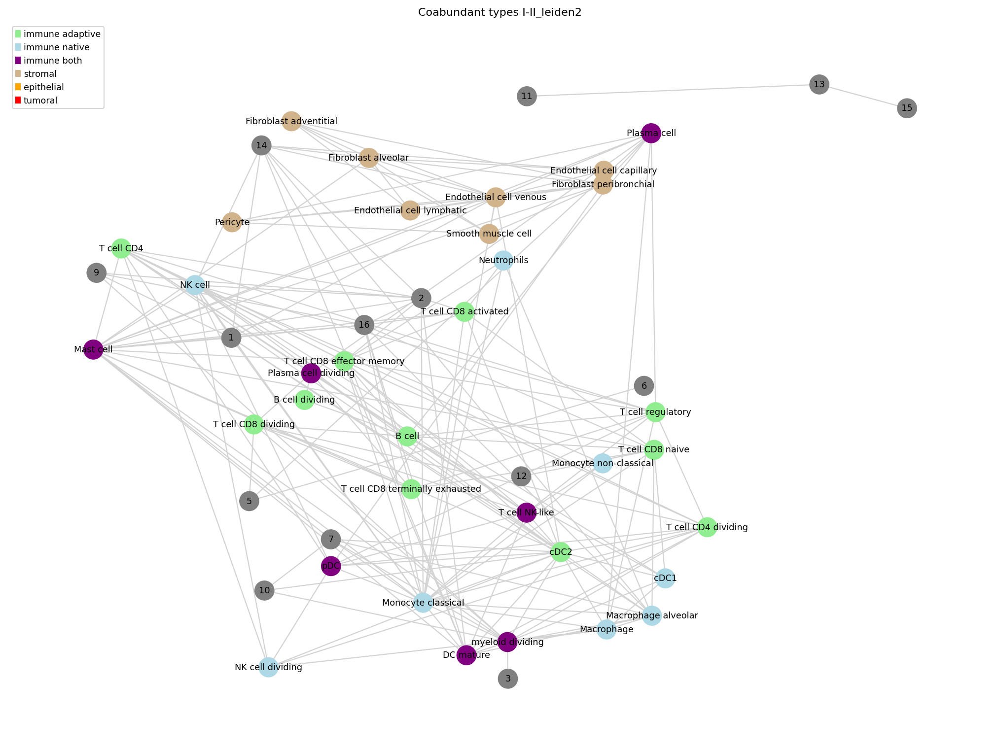

In [ ]:
from networkx.algorithms.community import greedy_modularity_communities

# Perform Newman clustering
newman_communities = list(greedy_modularity_communities(G))

# Map nodes to their community index
node_community_newman = {}
for idx, community in enumerate(newman_communities):
   for node in community:
      node_community_newman[node] = idx

# Assign colors to nodes based on community
node_colors_newman = [node_community_newman[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G,
   scale=30,  # SCAAAAAAAAAAAALE 1
   seed=1)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, newman_communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=1,
                               scale=4, k=3) # SCAAAAAAAAAAAALE 2
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

nx.draw(
    G, pos=pos, node_color=node_colors, node_size=300,
    edge_color="lightgray", with_labels=True, font_size=8,
    font_color="black",
)

legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Clique Percolation Visualization

En clique percolation vamos haciendo comunidades de n-cliques. Una n-clique es un grupo de nodos en donde los n
 están unidos entre si. Para hacer una comunidad debemos de tener varias n-cliques que tengan n-1 nodos en comun.
Esto nos garantiza que los nodos en esta comunidad estarán mas conectados entre si, que los que no están dentro.

Además, nuestras comunidades tendrán nodos en común pues solo estaremos buscando
 todas las posibles comunidades de cliques de tamaño n.

In [ ]:
from matplotlib.patches import Wedge
import numpy as np
import matplotlib.colors as mcolors

def draw_pie(ax, ratios, X, Y, size, colors):
    start = 0
    for ratio, color in zip(ratios, colors):
        x, y = X, Y
        radius = size
        theta1 = start * 360
        theta2 = (start + ratio) * 360
        wedge = Wedge((x, y), radius, theta1, theta2, facecolor=color)
        ax.add_artist(wedge)
        start += ratio
    # Ensure the aspect ratio is equal to make the pie chart round
    # This messes with the figure size
    # ax.set_aspect('equal')

def regular_polygon_vertices(n, side_length=1):
    # Calculate the radius of the circumscribed circle
    radius = side_length / (2 * np.sin(np.pi / n))
    
    # Calculate the vertices
    vertices = []
    for i in range(n):
        angle = 2 * np.pi * i / n
        x = radius * np.cos(angle)
        y = radius * np.sin(angle)
        vertices.append((x, y))
    
    return vertices

def draw_clique_graph(G, k_clique=2):
    communities = list(nx.algorithms.community.k_clique_communities(G, k_clique))

    # Convert sets to lists for easier handling
    communities = [list(c) for c in communities]
    print(f"Found {len(communities)} communities. Appending the rest")
    communities.append(list(set(G.nodes()) - set([x for xs in communities for x in xs])))

    # Map each node to the communities it belongs to
    node_communities = {node: [i for i, community in enumerate(communities) if node in community]
                        for community in communities for node in community}

    # Get a list of colors with no community = gray
    colors = list(mcolors.TABLEAU_COLORS.keys())[:len(communities)]
    colors[len(communities)-1] = 'gray'
    # Get the centers of clusters depending on the number of communities
    n = len(communities)  # Number of sides
    vertices = regular_polygon_vertices(n, side_length=1.5)
    pos = {}
    for center, comm in zip(vertices, communities):
        subgraph = G.subgraph(comm)
        subpos = nx.spring_layout(subgraph, center=center, seed=2, k =1.5)
        pos.update(subpos)

    # Avoid label overlap (optional adjustment)
    pos_b = pos.copy()
    visited_pairs = set()
    for k, v in pos.items():
        for k2, v2 in pos.items():
            if k != k2 and (k, k2) not in visited_pairs and (k2, k) not in visited_pairs:
                if abs(v[0] - v2[0]) < 0.4 and abs(v[1] - v2[1]) < 0.2:
                    pos[k2] = (v2[0], v2[1] + 0.2)
                visited_pairs.add((k, k2))


    # Draw nodes with pie charts
    fig, ax = plt.subplots(figsize=(14, 8))

    # Draw edges
    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color='gray', ax=ax)

    for node in G.nodes():
        x, y = pos[node]
        community_indices = node_communities.get(node, [])
        ratios = [1 / len(community_indices)] * len(community_indices)
        node_colors = [colors[i] for i in community_indices]
        draw_pie(ax, ratios, x, y, 0.05, node_colors)

    # Draw labels (optional)
    nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)

    plt.title(f'Overlapping Communities with k={k_clique}')
    plt.axis('off')
    plt.show()

Tenemos 3 comunidades con 3 y 4-cliques, lo que habla de que no tenemos un solo grupo muy interconectado entre si. Como cuando juntamos las early y las late.
Las grises (osea las que no estan en una clqiue) son en su mayoria tumorales. Lo que puede ser por lo temprano de estado de cáncer, o nos recuerda la heterogeneidad
de los tejidos y que no se repiten mucho los fenotipos de cáncer.

Found 3 communities. Appending the rest


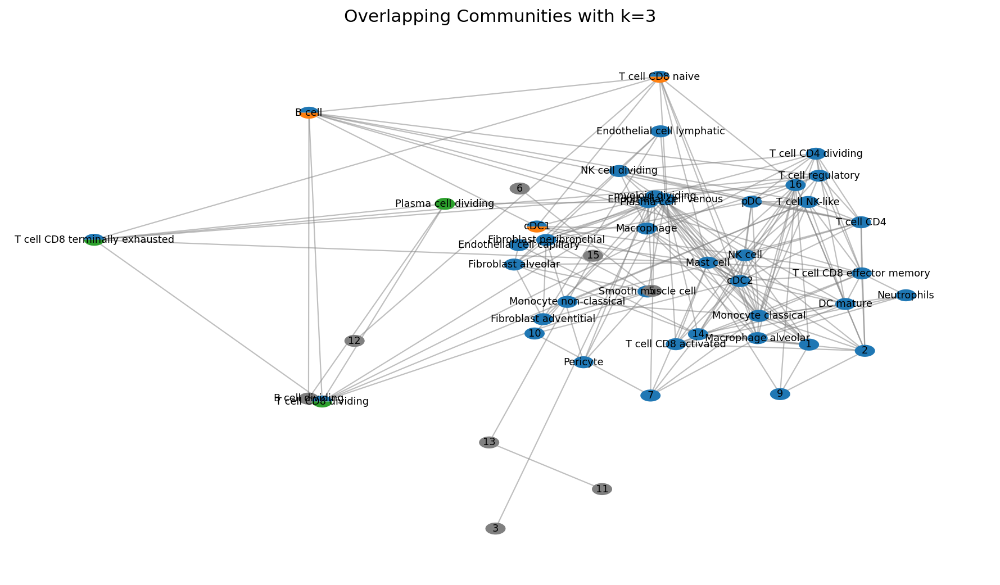

In [ ]:
draw_clique_graph(G, k_clique=3)

Con 4-cliques tenemos tres comunidades, que se va a ir disminuyendo hasta que tengamos...

Found 3 communities. Appending the rest


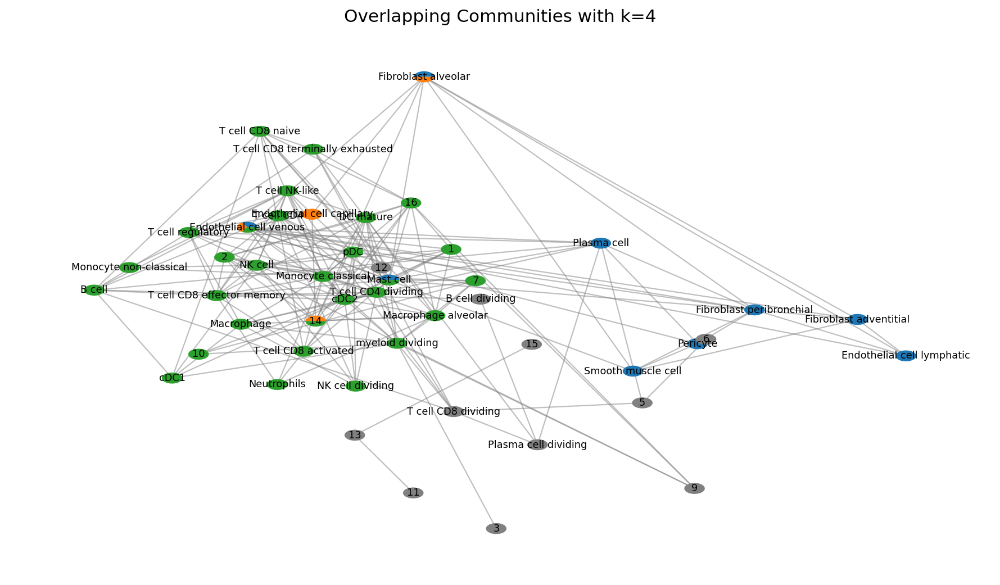

In [ ]:
draw_clique_graph(G, k_clique=4)

Tenemos dos comunidades maximales. QUe estan compuestas por inmunes y fibrobalstos. Es curisos porque son el enfoque de dos de los estudios.

Found 2 communities. Appending the rest


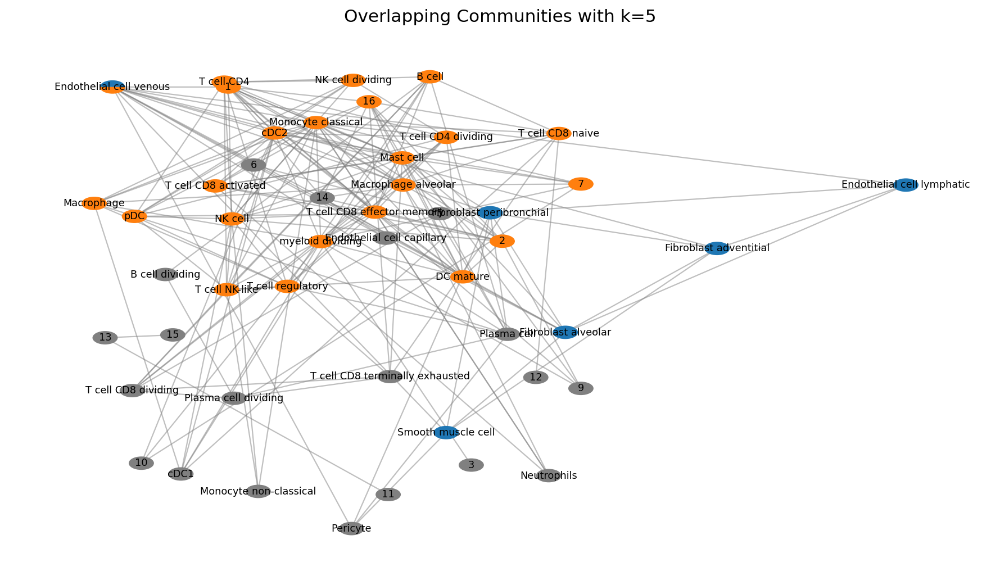

In [ ]:
draw_clique_graph(G, k_clique=5)

#### Force bundle

In [ ]:
import matplotlib.pyplot as plt

from datashader.layout import forceatlas2_layout
from datashader.bundling import hammer_bundle
import holoviews as hv
hv.extension("bokeh") 

import matplotlib.colors as mcolors

color_mapper = mcolors.ListedColormap(list(color_map.values()))

# Extract nodes and edges from the graph G
cnodes = pd.DataFrame(G.nodes(), columns=['name'])
cnodes['cat'] = cnodes['name'].map(cell_type_to_category).astype('category')

# Create a mapping from node names to their row numbers in the cnodes DataFrame
node_to_index = {node: idx for idx, node in enumerate(cnodes['name'])}

# Replace node names in edges with their corresponding row numbers
cedges = pd.DataFrame([(node_to_index[source], node_to_index[target]) for source, target in G.edges()], columns=['source', 'target'])

# rd = random_layout(     cnodes, cedges)
fd = forceatlas2_layout(cnodes, cedges, seed=0)
nodes = hv.Nodes((fd['x'], fd['y'], fd.index, fd['name']), vdims='cat')

# Plot with larger nodes and labels
bd1 = 0.01
bd2 = 0.02
bd3 = 0.03
bd4 = 0.1

# Plot the graph with larger nodes and labels
graph = hv.HoloMap({bd1: hv.Graph((cedges, nodes, hammer_bundle(fd, cedges, initial_bandwidth=bd1))).opts(
    node_size=20, 
    node_color='cat',
    node_line_alpha=0.0,
    border=0,
    node_cmap=color_mapper,
    edge_color='gray', 
    xaxis=None, 
    yaxis=None,
    clabel=f'Force-directed, bundled {bd1}',)
      for bd1 in [bd1,
                   bd2, bd3, bd4
                   ]}, 'Bandwith')

# For colorbars
labels = hv.Labels(fd, ['x', 'y'], 'name').opts(text_font_size='8pt', text_align='center', text_color='black')
colorbar = hv.NdOverlay({cat: hv.Points([1,1]).opts(color=color, size=0) for cat, color in color_map.items()})

# Combine graph, labels, and colorbar
plot = (graph * labels * colorbar).opts(
    legend_position='top_right',
    width=800, 
    height=700,
)
hv.output(plot)

ModuleNotFoundError: No module named 'datashader'

El force bundle parecía llamativo para poder identifcar mejor que célula interactua con que. 
Pero tiene el problema de que se unen caminos y pasan por nodos que ni estan conectados.
Para hace necesitamos ir cambiando la fuerza de conexion y ver como va pasando eso. De todos los dejamos porque es interactiva
 y nos deja ver las conexiones con el mouse.

In [ ]:
GI = G

### I-II Leiden Separated

In [ ]:
time = 'I-II_leiden2'
G = nx.read_edgelist(f"{aracne_dir}/net{time}.txt", data=(("MI", float),('p', float)), delimiter='\t')

#### Leiden Visualization

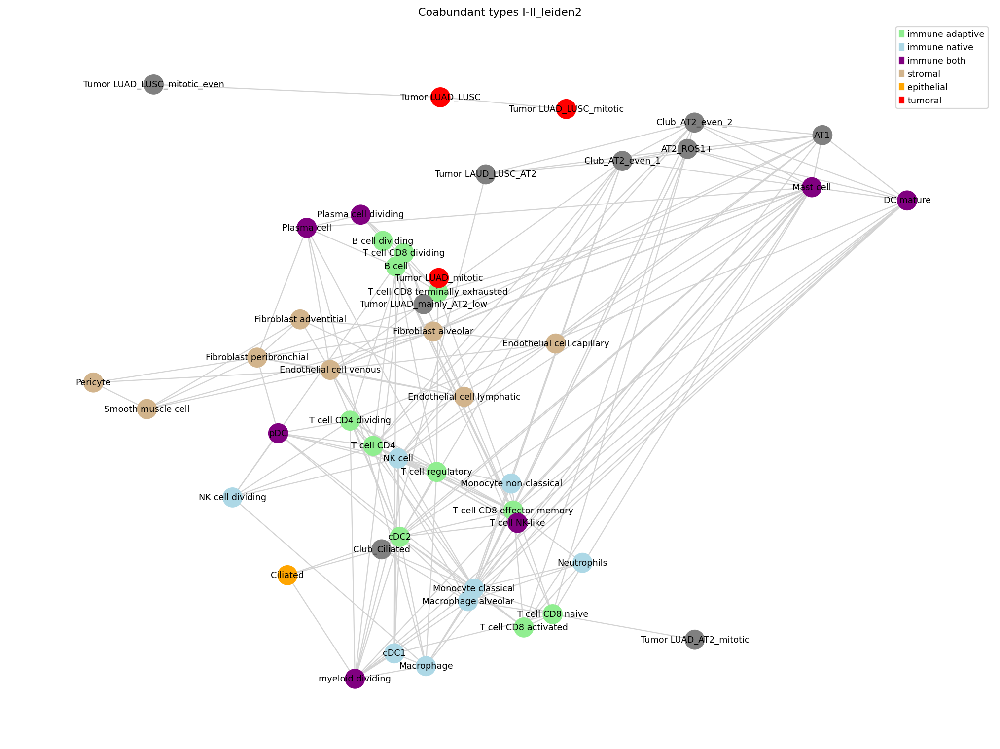

In [ ]:
import igraph as ig
import leidenalg

# Assuming G is your NetworkX graph
G_ig = ig.Graph.Adjacency((nx.to_numpy_array(G) > 0).tolist())
G_ig.vs['name'] = list(G.nodes())

partition = leidenalg.find_partition(G_ig, leidenalg.ModularityVertexPartition, seed=0)
# partition = leidenalg.CPMVertexPartition(G_ig, resolution_parameter = 0.1)
# Get communities as a list of lists of node names
communities = [G_ig.vs[cluster]['name'] for cluster in partition]

# Map nodes to their community index
node_community = {}
for idx, community in enumerate(communities):
    for node in community:
        node_community[node] = idx

# Assign colors to nodes based on community
node_colors_comm = [node_community[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G, scale=30, seed=429)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=0, scale=4)
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

# nx.draw(
#     G, pos=pos, node_color=node_colors, node_size=300,
#     edge_color="lightgray", with_labels=True, font_size=8,
#     font_color="black",
# )
# plt.show()

nx.draw(G, pos=pos, node_color=node_colors, node_size=300,
            edge_color="lightgray", with_labels=True, font_size=8,
        font_color="black")
legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Newman centrality clustering

Newman es mas exacto para redes pequeñas

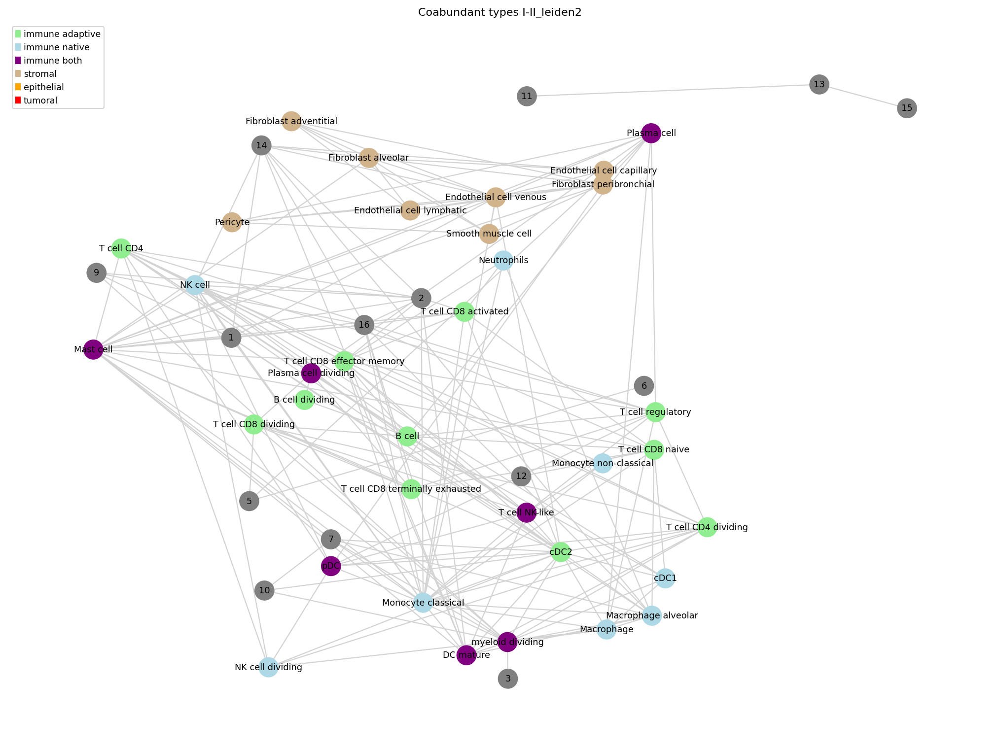

In [ ]:
from networkx.algorithms.community import greedy_modularity_communities

# Perform Newman clustering
newman_communities = list(greedy_modularity_communities(G))

# Map nodes to their community index
node_community_newman = {}
for idx, community in enumerate(newman_communities):
   for node in community:
      node_community_newman[node] = idx

# Assign colors to nodes based on community
node_colors_newman = [node_community_newman[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G,
   scale=30,  # SCAAAAAAAAAAAALE 1
   seed=1)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, newman_communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=1,
                               scale=4, k=3) # SCAAAAAAAAAAAALE 2
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

nx.draw(
    G, pos=pos, node_color=node_colors, node_size=300,
    edge_color="lightgray", with_labels=True, font_size=8,
    font_color="black",
)

legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Clique Percolation Visualization

En clique percolation vamos haciendo comunidades de n-cliques. Una n-clique es un grupo de nodos en donde los n
 están unidos entre si. Para hacer una comunidad debemos de tener varias n-cliques que tengan n-1 nodos en comun.
Esto nos garantiza que los nodos en esta comunidad estarán mas conectados entre si, que los que no están dentro.

Además, nuestras comunidades tendrán nodos en común pues solo estaremos buscando
 todas las posibles comunidades de cliques de tamaño n.

In [ ]:
from matplotlib.patches import Wedge
import numpy as np
import matplotlib.colors as mcolors

def draw_pie(ax, ratios, X, Y, size, colors):
    start = 0
    for ratio, color in zip(ratios, colors):
        x, y = X, Y
        radius = size
        theta1 = start * 360
        theta2 = (start + ratio) * 360
        wedge = Wedge((x, y), radius, theta1, theta2, facecolor=color)
        ax.add_artist(wedge)
        start += ratio
    # Ensure the aspect ratio is equal to make the pie chart round
    # This messes with the figure size
    # ax.set_aspect('equal')

def regular_polygon_vertices(n, side_length=1):
    # Calculate the radius of the circumscribed circle
    radius = side_length / (2 * np.sin(np.pi / n))
    
    # Calculate the vertices
    vertices = []
    for i in range(n):
        angle = 2 * np.pi * i / n
        x = radius * np.cos(angle)
        y = radius * np.sin(angle)
        vertices.append((x, y))
    
    return vertices

def draw_clique_graph(G, k_clique=2):
    communities = list(nx.algorithms.community.k_clique_communities(G, k_clique))

    # Convert sets to lists for easier handling
    communities = [list(c) for c in communities]
    print(f"Found {len(communities)} communities. Appending the rest")
    communities.append(list(set(G.nodes()) - set([x for xs in communities for x in xs])))

    # Map each node to the communities it belongs to
    node_communities = {node: [i for i, community in enumerate(communities) if node in community]
                        for community in communities for node in community}

    # Get a list of colors with no community = gray
    colors = list(mcolors.TABLEAU_COLORS.keys())[:len(communities)]
    colors[len(communities)-1] = 'gray'
    # Get the centers of clusters depending on the number of communities
    n = len(communities)  # Number of sides
    vertices = regular_polygon_vertices(n, side_length=1.5)
    pos = {}
    for center, comm in zip(vertices, communities):
        subgraph = G.subgraph(comm)
        subpos = nx.spring_layout(subgraph, center=center, seed=2, k =1.5)
        pos.update(subpos)

    # Avoid label overlap (optional adjustment)
    pos_b = pos.copy()
    visited_pairs = set()
    for k, v in pos.items():
        for k2, v2 in pos.items():
            if k != k2 and (k, k2) not in visited_pairs and (k2, k) not in visited_pairs:
                if abs(v[0] - v2[0]) < 0.4 and abs(v[1] - v2[1]) < 0.2:
                    pos[k2] = (v2[0], v2[1] + 0.2)
                visited_pairs.add((k, k2))


    # Draw nodes with pie charts
    fig, ax = plt.subplots(figsize=(14, 8))

    # Draw edges
    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color='gray', ax=ax)

    for node in G.nodes():
        x, y = pos[node]
        community_indices = node_communities.get(node, [])
        ratios = [1 / len(community_indices)] * len(community_indices)
        node_colors = [colors[i] for i in community_indices]
        draw_pie(ax, ratios, x, y, 0.05, node_colors)

    # Draw labels (optional)
    nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)

    plt.title(f'Overlapping Communities with k={k_clique}')
    plt.axis('off')
    plt.show()

Tenemos 3 comunidades con 3 y 4-cliques, lo que habla de que no tenemos un solo grupo muy interconectado entre si. Como cuando juntamos las early y las late.
Las grises (osea las que no estan en una clqiue) son en su mayoria tumorales. Lo que puede ser por lo temprano de estado de cáncer, o nos recuerda la heterogeneidad
de los tejidos y que no se repiten mucho los fenotipos de cáncer.

Found 3 communities. Appending the rest


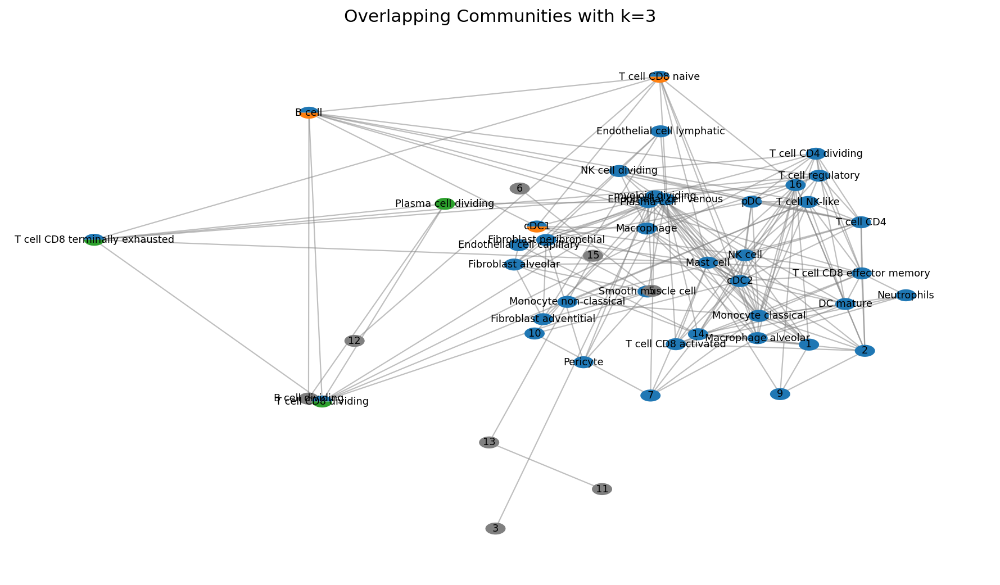

In [ ]:
draw_clique_graph(G, k_clique=3)

Con 4-cliques tenemos tres comunidades, que se va a ir disminuyendo hasta que tengamos...

Found 3 communities. Appending the rest


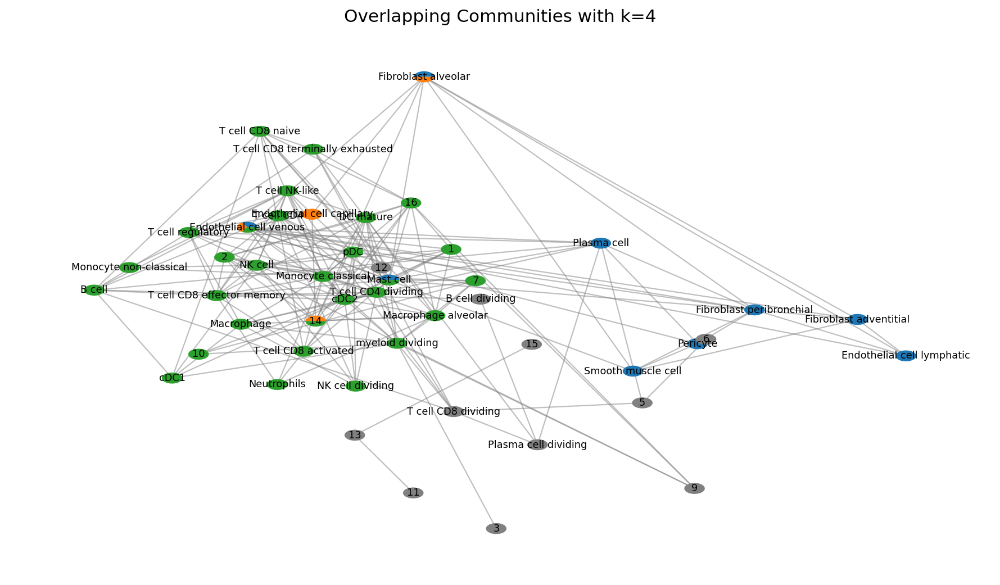

In [ ]:
draw_clique_graph(G, k_clique=4)

Tenemos dos comunidades maximales. QUe estan compuestas por inmunes y fibrobalstos. Es curisos porque son el enfoque de dos de los estudios.

Found 2 communities. Appending the rest


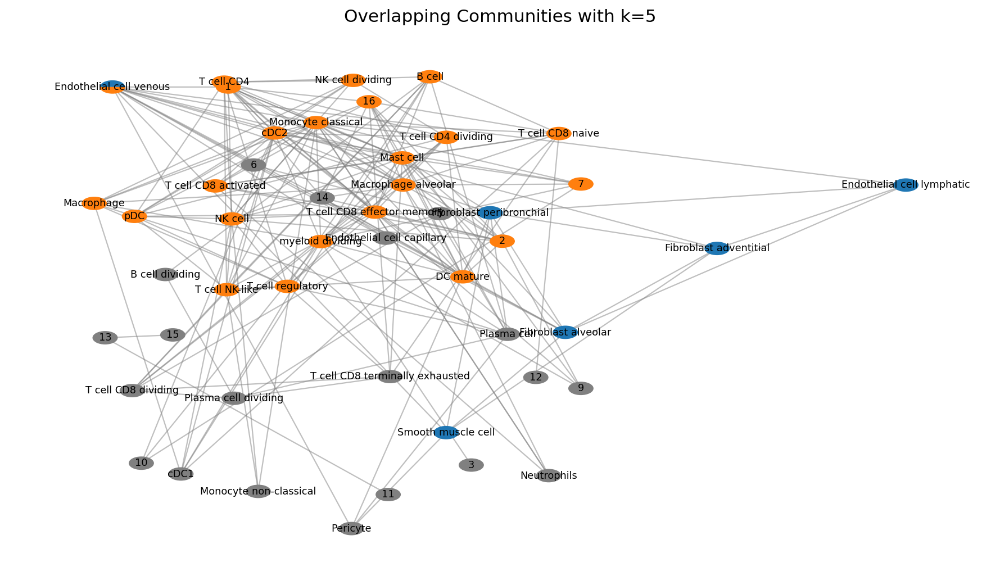

In [ ]:
draw_clique_graph(G, k_clique=5)

#### Force bundle

In [ ]:
import matplotlib.pyplot as plt

from datashader.layout import forceatlas2_layout
from datashader.bundling import hammer_bundle
import holoviews as hv
hv.extension("bokeh") 

import matplotlib.colors as mcolors

color_mapper = mcolors.ListedColormap(list(color_map.values()))

# Extract nodes and edges from the graph G
cnodes = pd.DataFrame(G.nodes(), columns=['name'])
cnodes['cat'] = cnodes['name'].map(cell_type_to_category).astype('category')

# Create a mapping from node names to their row numbers in the cnodes DataFrame
node_to_index = {node: idx for idx, node in enumerate(cnodes['name'])}

# Replace node names in edges with their corresponding row numbers
cedges = pd.DataFrame([(node_to_index[source], node_to_index[target]) for source, target in G.edges()], columns=['source', 'target'])

# rd = random_layout(     cnodes, cedges)
fd = forceatlas2_layout(cnodes, cedges, seed=0)
nodes = hv.Nodes((fd['x'], fd['y'], fd.index, fd['name']), vdims='cat')

# Plot with larger nodes and labels
bd1 = 0.01
bd2 = 0.02
bd3 = 0.03
bd4 = 0.1

# Plot the graph with larger nodes and labels
graph = hv.HoloMap({bd1: hv.Graph((cedges, nodes, hammer_bundle(fd, cedges, initial_bandwidth=bd1))).opts(
    node_size=20, 
    node_color='cat',
    node_line_alpha=0.0,
    border=0,
    node_cmap=color_mapper,
    edge_color='gray', 
    xaxis=None, 
    yaxis=None,
    clabel=f'Force-directed, bundled {bd1}',)
      for bd1 in [bd1,
                   bd2, bd3, bd4
                   ]}, 'Bandwith')

# For colorbars
labels = hv.Labels(fd, ['x', 'y'], 'name').opts(text_font_size='8pt', text_align='center', text_color='black')
colorbar = hv.NdOverlay({cat: hv.Points([1,1]).opts(color=color, size=0) for cat, color in color_map.items()})

# Combine graph, labels, and colorbar
plot = (graph * labels * colorbar).opts(
    legend_position='top_right',
    width=800, 
    height=700,
)
hv.output(plot)

ModuleNotFoundError: No module named 'datashader'

El force bundle parecía llamativo para poder identifcar mejor que célula interactua con que. 
Pero tiene el problema de que se unen caminos y pasan por nodos que ni estan conectados.
Para hace necesitamos ir cambiando la fuerza de conexion y ver como va pasando eso. De todos los dejamos porque es interactiva
 y nos deja ver las conexiones con el mouse.

In [ ]:
GI = G

### I-II Leiden with Zuani

In [ ]:
time = 'I-II_leiden'
G = nx.read_edgelist(f"{aracne_dir}/net{time}.txt", data=(("MI", float),('p', float)), delimiter='\t')

#### Leiden Visualization

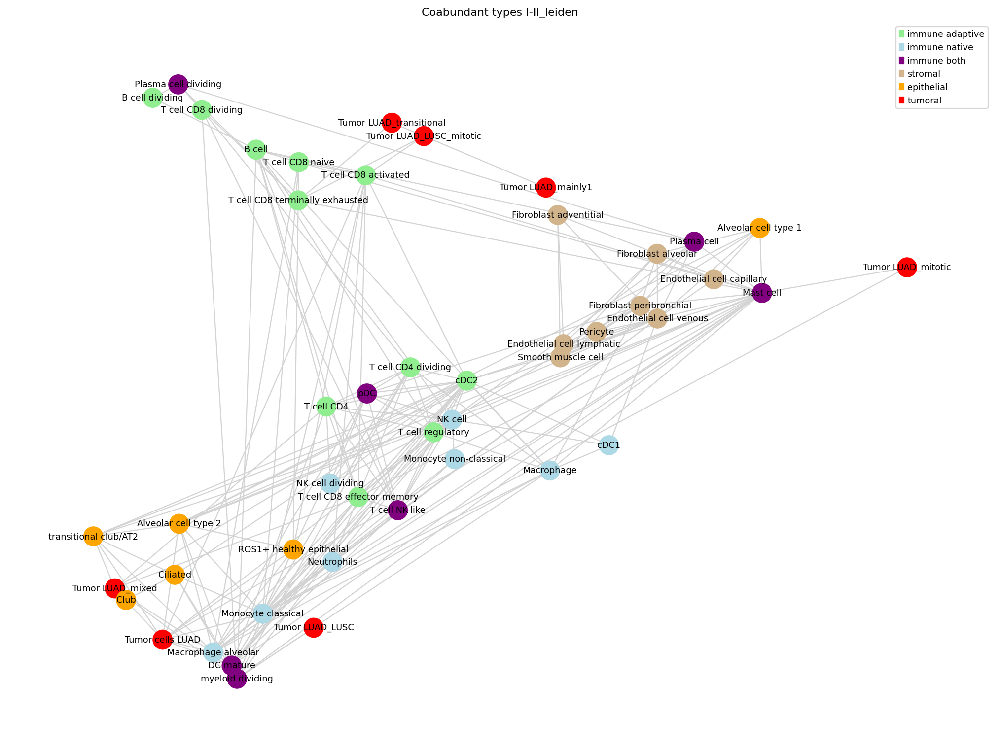

In [ ]:
import igraph as ig
import leidenalg

# Assuming G is your NetworkX graph
G_ig = ig.Graph.Adjacency((nx.to_numpy_array(G) > 0).tolist())
G_ig.vs['name'] = list(G.nodes())

partition = leidenalg.find_partition(G_ig, leidenalg.ModularityVertexPartition, seed=0)
# partition = leidenalg.CPMVertexPartition(G_ig, resolution_parameter = 0.1)
# Get communities as a list of lists of node names
communities = [G_ig.vs[cluster]['name'] for cluster in partition]

# Map nodes to their community index
node_community = {}
for idx, community in enumerate(communities):
    for node in community:
        node_community[node] = idx

# Assign colors to nodes based on community
node_colors_comm = [node_community[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G, scale=30, seed=429)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=0, scale=4)
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

# nx.draw(
#     G, pos=pos, node_color=node_colors, node_size=300,
#     edge_color="lightgray", with_labels=True, font_size=8,
#     font_color="black",
# )
# plt.show()

nx.draw(G, pos=pos, node_color=node_colors, node_size=300,
            edge_color="lightgray", with_labels=True, font_size=8,
        font_color="black")
legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Newman centrality clustering

Newman es mas exacto para redes pequeñas

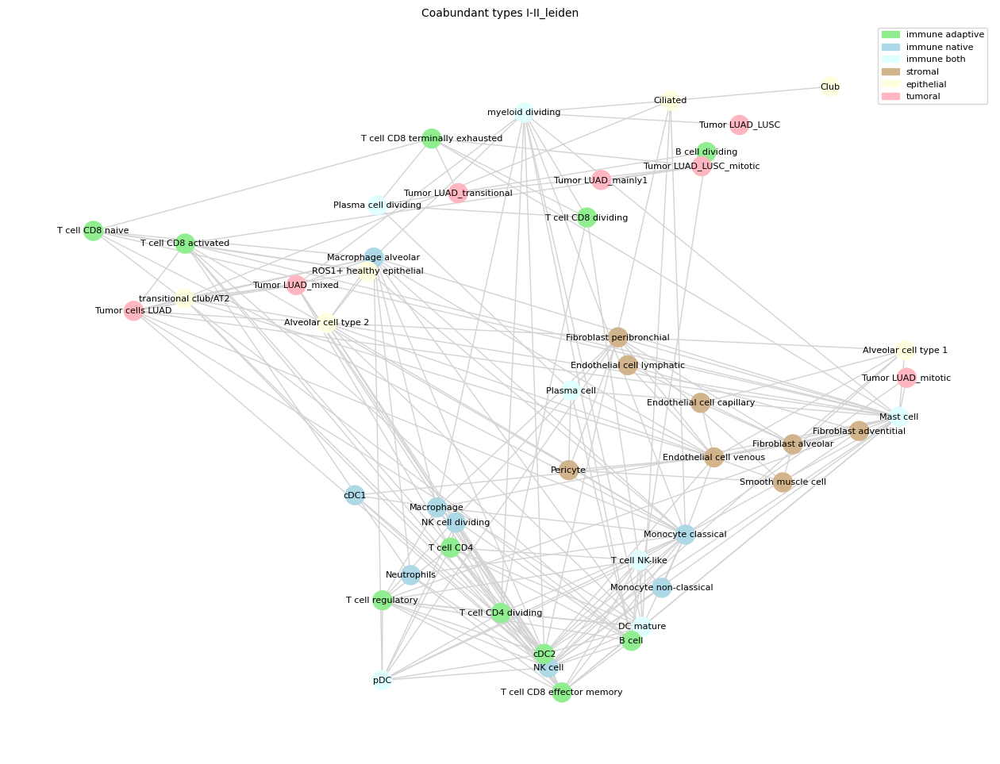

In [ ]:
from networkx.algorithms.community import greedy_modularity_communities

# Perform Newman clustering
newman_communities = list(greedy_modularity_communities(G))

# Map nodes to their community index
node_community_newman = {}
for idx, community in enumerate(newman_communities):
   for node in community:
      node_community_newman[node] = idx

# Assign colors to nodes based on community
node_colors_newman = [node_community_newman[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G,
   scale=30,  # SCAAAAAAAAAAAALE 1
   seed=1)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, newman_communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=1,
                               scale=4, k=3) # SCAAAAAAAAAAAALE 2
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

nx.draw(
    G, pos=pos, node_color=node_colors, node_size=300,
    edge_color="lightgray", with_labels=True, font_size=8,
    font_color="black",
)

legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Clique Percolation Visualization

En clique percolation vamos haciendo comunidades de n-cliques. Una n-clique es un grupo de nodos en donde los n
 están unidos entre si. Para hacer una comunidad debemos de tener varias n-cliques que tengan n-1 nodos en comun.
Esto nos garantiza que los nodos en esta comunidad estarán mas conectados entre si, que los que no están dentro.

Además, nuestras comunidades tendrán nodos en común pues solo estaremos buscando
 todas las posibles comunidades de cliques de tamaño n.

In [ ]:
from matplotlib.patches import Wedge
import numpy as np
import matplotlib.colors as mcolors

def draw_pie(ax, ratios, X, Y, size, colors):
    start = 0
    for ratio, color in zip(ratios, colors):
        x, y = X, Y
        radius = size
        theta1 = start * 360
        theta2 = (start + ratio) * 360
        wedge = Wedge((x, y), radius, theta1, theta2, facecolor=color)
        ax.add_artist(wedge)
        start += ratio
    # Ensure the aspect ratio is equal to make the pie chart round
    # This messes with the figure size
    # ax.set_aspect('equal')

def regular_polygon_vertices(n, side_length=1):
    # Calculate the radius of the circumscribed circle
    radius = side_length / (2 * np.sin(np.pi / n))
    
    # Calculate the vertices
    vertices = []
    for i in range(n):
        angle = 2 * np.pi * i / n
        x = radius * np.cos(angle)
        y = radius * np.sin(angle)
        vertices.append((x, y))
    
    return vertices

def draw_clique_graph(G, k_clique=2):
    communities = list(nx.algorithms.community.k_clique_communities(G, k_clique))

    # Convert sets to lists for easier handling
    communities = [list(c) for c in communities]
    print(f"Found {len(communities)} communities. Appending the rest")
    communities.append(list(set(G.nodes()) - set([x for xs in communities for x in xs])))

    # Map each node to the communities it belongs to
    node_communities = {node: [i for i, community in enumerate(communities) if node in community]
                        for community in communities for node in community}

    # Get a list of colors with no community = gray
    colors = list(mcolors.TABLEAU_COLORS.keys())[:len(communities)]
    colors[len(communities)-1] = 'gray'
    # Get the centers of clusters depending on the number of communities
    n = len(communities)  # Number of sides
    vertices = regular_polygon_vertices(n, side_length=1.5)
    pos = {}
    for center, comm in zip(vertices, communities):
        subgraph = G.subgraph(comm)
        subpos = nx.spring_layout(subgraph, center=center, seed=2, k =1.5)
        pos.update(subpos)

    # Avoid label overlap (optional adjustment)
    pos_b = pos.copy()
    visited_pairs = set()
    for k, v in pos.items():
        for k2, v2 in pos.items():
            if k != k2 and (k, k2) not in visited_pairs and (k2, k) not in visited_pairs:
                if abs(v[0] - v2[0]) < 0.4 and abs(v[1] - v2[1]) < 0.2:
                    pos[k2] = (v2[0], v2[1] + 0.2)
                visited_pairs.add((k, k2))


    # Draw nodes with pie charts
    fig, ax = plt.subplots(figsize=(14, 8))

    # Draw edges
    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color='gray', ax=ax)

    for node in G.nodes():
        x, y = pos[node]
        community_indices = node_communities.get(node, [])
        ratios = [1 / len(community_indices)] * len(community_indices)
        node_colors = [colors[i] for i in community_indices]
        draw_pie(ax, ratios, x, y, 0.05, node_colors)

    # Draw labels (optional)
    nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)

    plt.title(f'Overlapping Communities with k={k_clique}')
    plt.axis('off')
    plt.show()

Solo tenemos varias comunidades con 3-cliques. Lo que nos habla de que en genreal nuestras celulas tiene mucha coabundancia entre ellas. 
Las grises son en su mayoria tumorales. Lo que puede ser por lo temprano de estado de cáncer, o nos recuerda la heterogeneidad
de los tejidos y que no se repiten mucho los fenotipos de cáncer.

Found 3 communities. Appending the rest


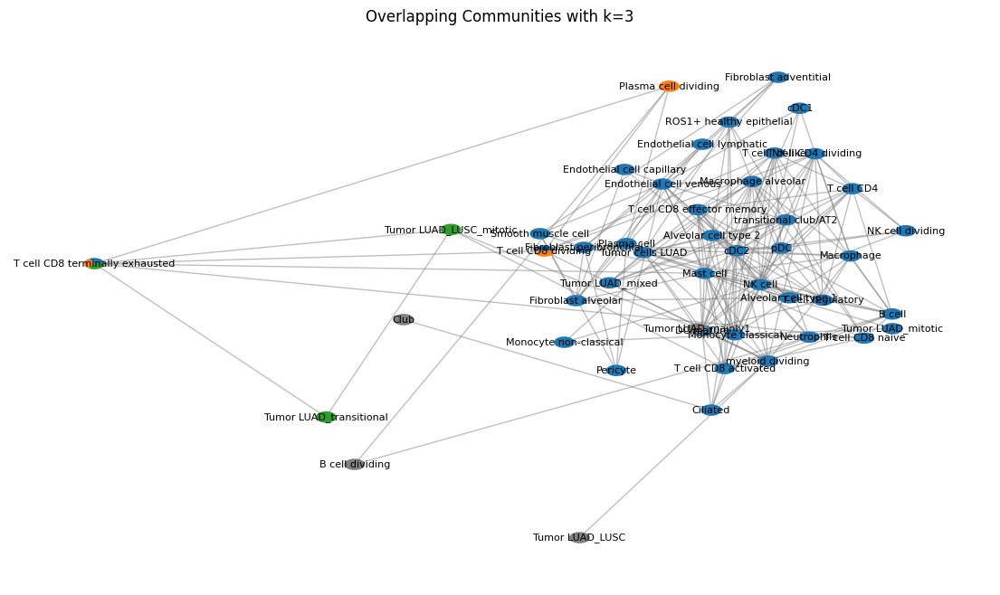

In [ ]:
draw_clique_graph(G, k_clique=3)

A partir de 4-cliques solo tenemos una comunidad, que se va a ir disminuyendo hasta que tengamos...

Found 1 communities. Appending the rest


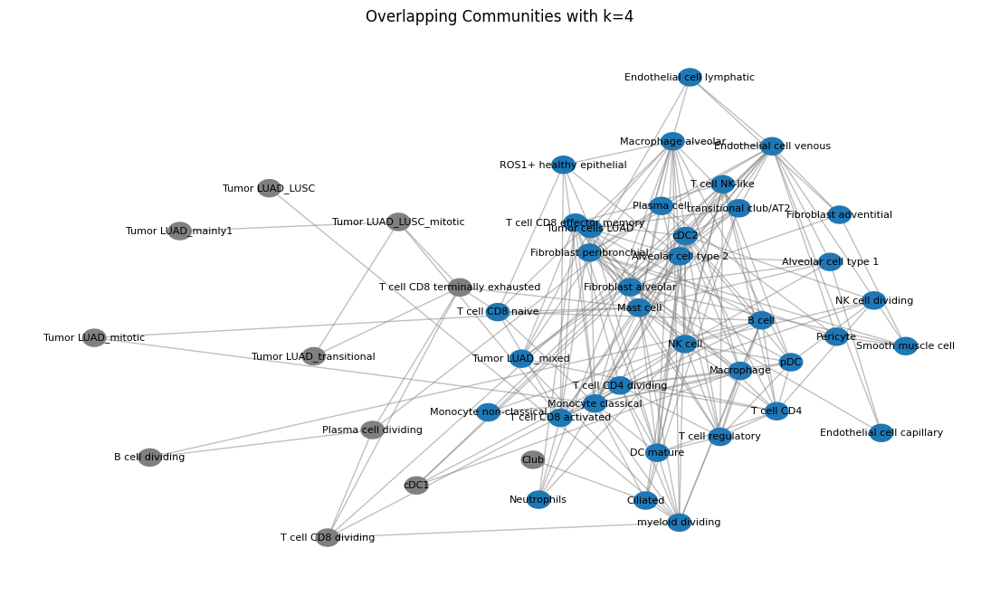

In [ ]:
draw_clique_graph(G, k_clique=4)

Nuesta comunidad maximal es de 7-cliques y esta compuesta de puras celulas inmunes. Celulas activas en la respuesta adaptativa.

Found 1 communities. Appending the rest


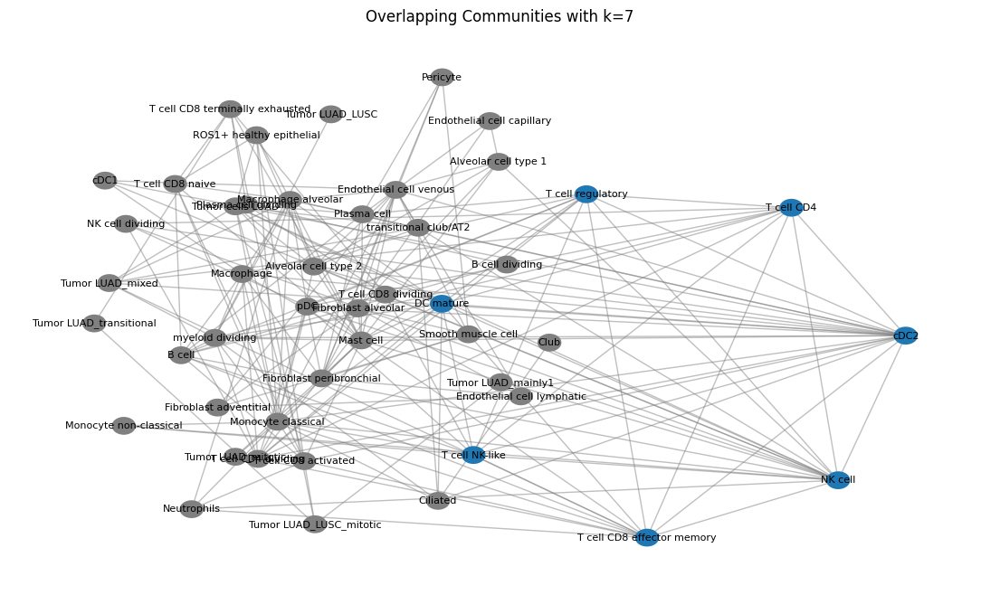

In [ ]:
draw_clique_graph(G, k_clique=7)

#### Force bundle

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
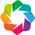

:HoloMap   [Bandwith]
   :Overlay
      .Graph.I     :Graph   [source,target]
      .Labels.I    :Labels   [x,y]   (name)
      .NdOverlay.I :NdOverlay   [Element]
         :Points   [x,y]

In [ ]:
import matplotlib.pyplot as plt

from datashader.layout import forceatlas2_layout
from datashader.bundling import hammer_bundle
import holoviews as hv
hv.extension("bokeh") 

import matplotlib.colors as mcolors

color_mapper = mcolors.ListedColormap(list(color_map.values()))

# Extract nodes and edges from the graph G
cnodes = pd.DataFrame(G.nodes(), columns=['name'])
cnodes['cat'] = cnodes['name'].map(cell_type_to_category).astype('category')

# Create a mapping from node names to their row numbers in the cnodes DataFrame
node_to_index = {node: idx for idx, node in enumerate(cnodes['name'])}

# Replace node names in edges with their corresponding row numbers
cedges = pd.DataFrame([(node_to_index[source], node_to_index[target]) for source, target in G.edges()], columns=['source', 'target'])

# rd = random_layout(     cnodes, cedges)
fd = forceatlas2_layout(cnodes, cedges, seed=0)
nodes = hv.Nodes((fd['x'], fd['y'], fd.index, fd['name']), vdims='cat')

# Plot with larger nodes and labels
bd1 = 0.01
bd2 = 0.02
bd3 = 0.03
bd4 = 0.1

# Plot the graph with larger nodes and labels
graph = hv.HoloMap({bd1: hv.Graph((cedges, nodes, hammer_bundle(fd, cedges, initial_bandwidth=bd1))).opts(
    node_size=20, 
    node_color='cat',
    node_line_alpha=0.0,
    border=0,
    node_cmap=color_mapper,
    edge_color='gray', 
    xaxis=None, 
    yaxis=None,
    clabel=f'Force-directed, bundled {bd1}',)
      for bd1 in [bd1,
                   bd2, bd3, bd4
                   ]}, 'Bandwith')

# For colorbars
labels = hv.Labels(fd, ['x', 'y'], 'name').opts(text_font_size='8pt', text_align='center', text_color='black')
colorbar = hv.NdOverlay({cat: hv.Points([1,1]).opts(color=color, size=0) for cat, color in color_map.items()})

# Combine graph, labels, and colorbar
plot = (graph * labels * colorbar).opts(
    legend_position='top_right',
    width=800, 
    height=700,
)
hv.output(plot)

El force bundle parecía llamativo para poder identifcar mejor que célula interactua con que. 
Pero tiene el problema de que se unen caminos y pasan por nodos que ni estan conectados.
Para hace necesitamos ir cambiando la fuerza de conexion y ver como va pasando eso. De todos los dejamos porque es interactiva
 y nos deja ver las conexiones con el mouse.

In [ ]:
GI = G

### III-IV Leiden with Zuani

In [ ]:
time = 'III-IV_leiden'
G = nx.read_edgelist(f"{aracne_dir}/net{time}.txt", data=(("MI", float),('p', float)), delimiter='\t')

#### Leiden Visualization

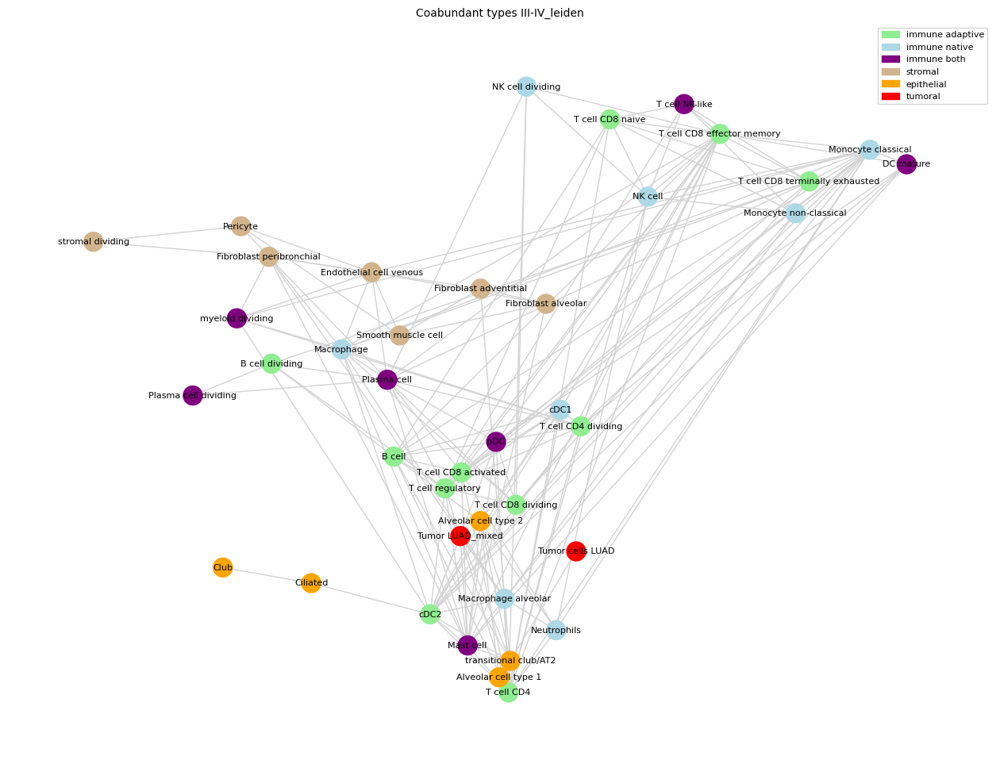

In [ ]:
import igraph as ig
import leidenalg

# Assuming G is your NetworkX graph
G_ig = ig.Graph.Adjacency((nx.to_numpy_array(G) > 0).tolist())
G_ig.vs['name'] = list(G.nodes())

partition = leidenalg.find_partition(G_ig, leidenalg.ModularityVertexPartition, seed=0)
# partition = leidenalg.CPMVertexPartition(G_ig, resolution_parameter = 0.1)
# Get communities as a list of lists of node names
communities = [G_ig.vs[cluster]['name'] for cluster in partition]

# Map nodes to their community index
node_community = {}
for idx, community in enumerate(communities):
    for node in community:
        node_community[node] = idx

# Assign colors to nodes based on community
node_colors_comm = [node_community[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G, scale=30, seed=429)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=0, scale=4)
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

# nx.draw(
#     G, pos=pos, node_color=node_colors, node_size=300,
#     edge_color="lightgray", with_labels=True, font_size=8,
#     font_color="black",
# )
# plt.show()

nx.draw(G, pos=pos, node_color=node_colors, node_size=300,
            edge_color="lightgray", with_labels=True, font_size=8,
        font_color="black")
legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Newman centrality clustering

Newman es mas exacto para redes pequeñas

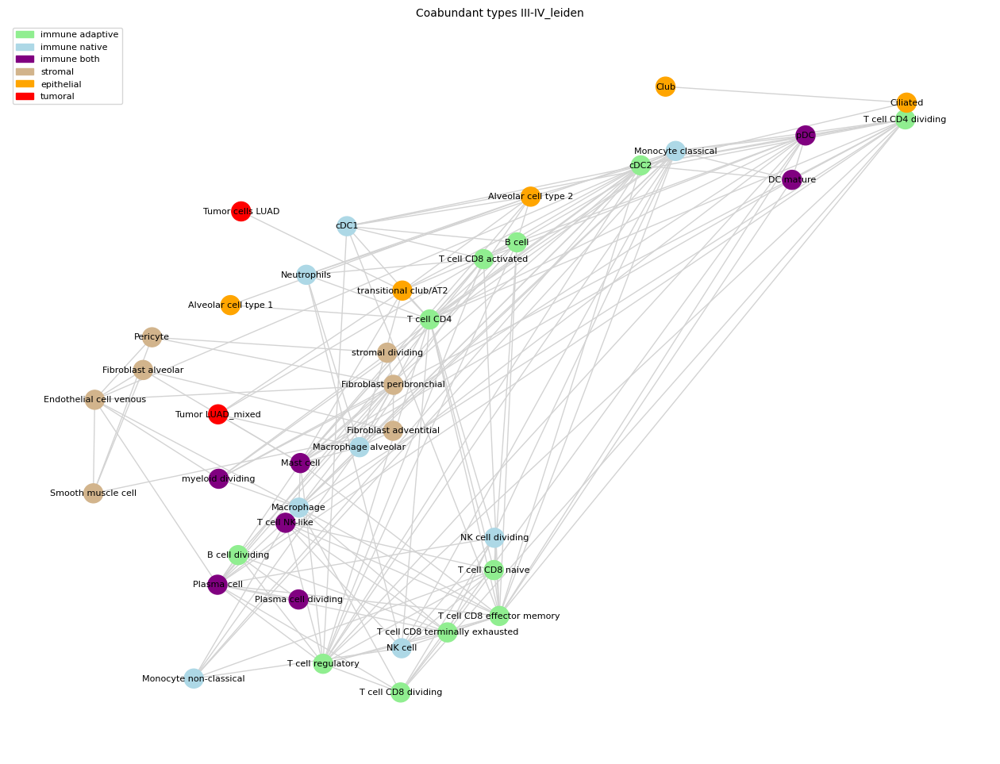

In [ ]:
from networkx.algorithms.community import greedy_modularity_communities

# Perform Newman clustering
newman_communities = list(greedy_modularity_communities(G))

# Map nodes to their community index
node_community_newman = {}
for idx, community in enumerate(newman_communities):
   for node in community:
      node_community_newman[node] = idx

# Assign colors to nodes based on community
node_colors_newman = [node_community_newman[node] for node in G.nodes()]

plt.figure(figsize=(16, 12))
plt.title(f'Coabundant types {time}', fontsize=10)

# Compute positions for the node clusters
superpos = nx.spring_layout(G,
   scale=30,  # SCAAAAAAAAAAAALE 1
   seed=1)
centers = list(superpos.values())
pos = {}
for center, comm in zip(centers, newman_communities):
    subgraph = G.subgraph(comm)
    subpos = nx.spring_layout(subgraph, center=center, seed=1,
                               scale=4, k=3) # SCAAAAAAAAAAAALE 2
    pos.update(subpos)

# Avoid label overlap (optional adjustment)
for k, v in pos.items():
    for k2, v2 in pos.items():
        if k != k2 and abs(v[0] - v2[0]) < 700 and abs(v[1] - v2[1]) < 20:
            pos[k2] = (v2[0], v2[1] + 50)

nx.draw(
    G, pos=pos, node_color=node_colors, node_size=300,
    edge_color="lightgray", with_labels=True, font_size=8,
    font_color="black",
)

legend_handles = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
plt.legend(handles=legend_handles, loc='best', fontsize=8)
plt.show()

#### Clique Percolation Visualization

En clique percolation vamos haciendo comunidades de n-cliques. Una n-clique es un grupo de nodos en donde los n
 están unidos entre si. Para hacer una comunidad debemos de tener varias n-cliques que tengan n-1 nodos en comun.
Esto nos garantiza que los nodos en esta comunidad estarán mas conectados entre si, que los que no están dentro.

Además, nuestras comunidades tendrán nodos en común pues solo estaremos buscando
 todas las posibles comunidades de cliques de tamaño n.

In [ ]:
from matplotlib.patches import Wedge
import numpy as np
import matplotlib.colors as mcolors

def draw_pie(ax, ratios, X, Y, size, colors):
    start = 0
    for ratio, color in zip(ratios, colors):
        x, y = X, Y
        radius = size
        theta1 = start * 360
        theta2 = (start + ratio) * 360
        wedge = Wedge((x, y), radius, theta1, theta2, facecolor=color)
        ax.add_artist(wedge)
        start += ratio
    # Ensure the aspect ratio is equal to make the pie chart round
    # This messes with the figure size
    # ax.set_aspect('equal')

def regular_polygon_vertices(n, side_length=1):
    # Calculate the radius of the circumscribed circle
    radius = side_length / (2 * np.sin(np.pi / n))
    
    # Calculate the vertices
    vertices = []
    for i in range(n):
        angle = 2 * np.pi * i / n
        x = radius * np.cos(angle)
        y = radius * np.sin(angle)
        vertices.append((x, y))
    
    return vertices

def draw_clique_graph(G, k_clique=2):
    communities = list(nx.algorithms.community.k_clique_communities(G, k_clique))

    # Convert sets to lists for easier handling
    communities = [list(c) for c in communities]
    print(f"Found {len(communities)} communities. Appending the rest")
    communities.append(list(set(G.nodes()) - set([x for xs in communities for x in xs])))

    # Map each node to the communities it belongs to
    node_communities = {node: [i for i, community in enumerate(communities) if node in community]
                        for community in communities for node in community}

    # Get a list of colors with no community = gray
    colors = list(mcolors.TABLEAU_COLORS.keys())[:len(communities)]
    colors[len(communities)-1] = 'gray'
    # Get the centers of clusters depending on the number of communities
    n = len(communities)  # Number of sides
    vertices = regular_polygon_vertices(n, side_length=1.5)
    pos = {}
    for center, comm in zip(vertices, communities):
        subgraph = G.subgraph(comm)
        subpos = nx.spring_layout(subgraph, center=center, seed=2, k =1.5)
        pos.update(subpos)

    # Avoid label overlap (optional adjustment)
    pos_b = pos.copy()
    visited_pairs = set()
    for k, v in pos.items():
        for k2, v2 in pos.items():
            if k != k2 and (k, k2) not in visited_pairs and (k2, k) not in visited_pairs:
                if abs(v[0] - v2[0]) < 0.4 and abs(v[1] - v2[1]) < 0.2:
                    pos[k2] = (v2[0], v2[1] + 0.2)
                visited_pairs.add((k, k2))


    # Draw nodes with pie charts
    fig, ax = plt.subplots(figsize=(14, 8))

    # Draw edges
    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color='gray', ax=ax)

    for node in G.nodes():
        x, y = pos[node]
        community_indices = node_communities.get(node, [])
        ratios = [1 / len(community_indices)] * len(community_indices)
        node_colors = [colors[i] for i in community_indices]
        draw_pie(ax, ratios, x, y, 0.05, node_colors)

    # Draw labels (optional)
    nx.draw_networkx_labels(G, pos, font_size=8, ax=ax)

    plt.title(f'Overlapping Communities with k={k_clique}')
    plt.axis('off')
    plt.show()

Solo tenemos varias comunidades con 5-cliques. Lo que nos habla de que en genreal nuestras celulas tiene mucha coabundancia entre ellas. 
Las grises son en su mayoria tumorales. Lo que puede ser por lo temprano de estado de cáncer, o nos recuerda la heterogeneidad
de los tejidos y que no se repiten mucho los fenotipos de cáncer.

Found 3 communities. Appending the rest


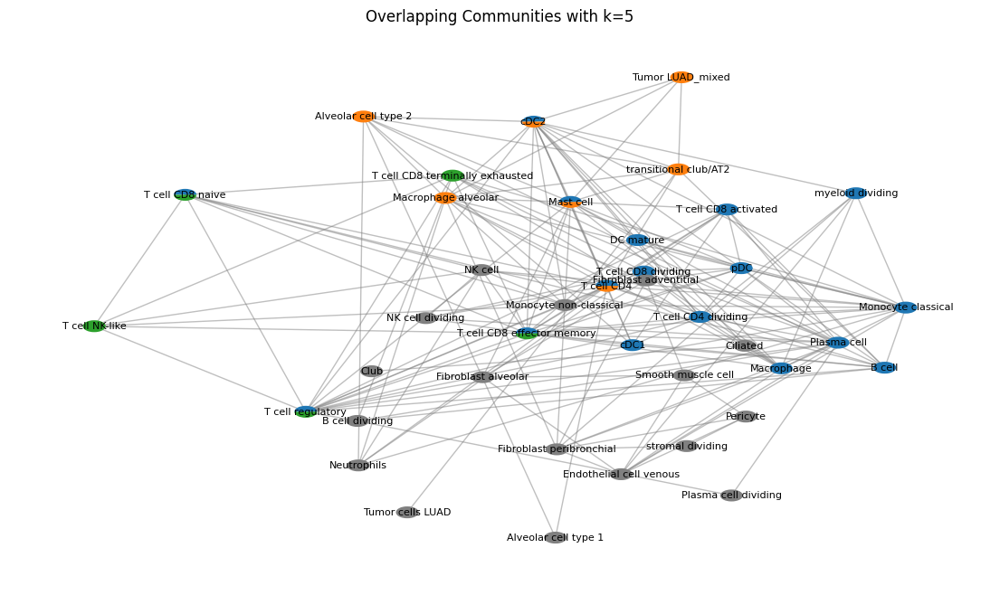

In [ ]:
draw_clique_graph(G, k_clique=5)

A partir de 4-cliques solo tenemos una comunidad, que se va a ir disminuyendo hasta que tengamos...

Found 1 communities. Appending the rest


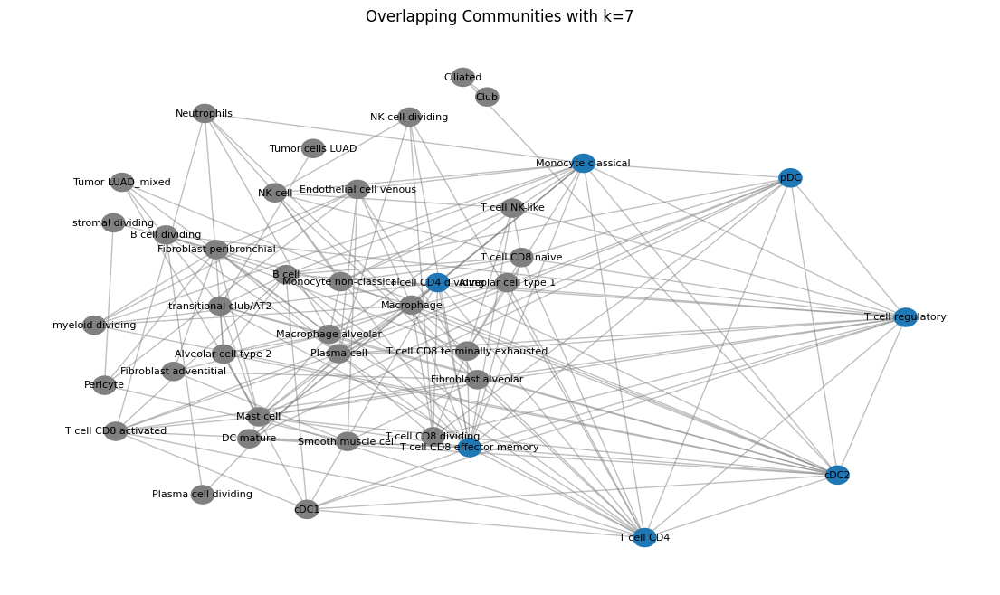

In [ ]:
draw_clique_graph(G, k_clique=7)

Nuesta comunidad maximal es de 7-cliques y esta compuesta de puras celulas inmunes. Celulas activas en la respuesta adaptativa.

#### Force bundle

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
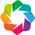

:HoloMap   [Bandwith]
   :Overlay
      .Graph.I     :Graph   [source,target]
      .Labels.I    :Labels   [x,y]   (name)
      .NdOverlay.I :NdOverlay   [Element]
         :Points   [x,y]

In [ ]:
import matplotlib.pyplot as plt

from datashader.layout import forceatlas2_layout
from datashader.bundling import hammer_bundle
import holoviews as hv
hv.extension("bokeh") 

import matplotlib.colors as mcolors

color_mapper = mcolors.ListedColormap(list(color_map.values()))

# Extract nodes and edges from the graph G
cnodes = pd.DataFrame(G.nodes(), columns=['name'])
cnodes['cat'] = cnodes['name'].map(cell_type_to_category).astype('category')

# Create a mapping from node names to their row numbers in the cnodes DataFrame
node_to_index = {node: idx for idx, node in enumerate(cnodes['name'])}

# Replace node names in edges with their corresponding row numbers
cedges = pd.DataFrame([(node_to_index[source], node_to_index[target]) for source, target in G.edges()], columns=['source', 'target'])

# rd = random_layout(     cnodes, cedges)
fd = forceatlas2_layout(cnodes, cedges, seed=0)
nodes = hv.Nodes((fd['x'], fd['y'], fd.index, fd['name']), vdims='cat')

# Plot with larger nodes and labels
bd1 = 0.01
bd2 = 0.02
bd3 = 0.03
bd4 = 0.1

# Plot the graph with larger nodes and labels
graph = hv.HoloMap({bd1: hv.Graph((cedges, nodes, hammer_bundle(fd, cedges, initial_bandwidth=bd1))).opts(
    node_size=20, 
    node_color='cat',
    node_line_alpha=0.0,
    border=0,
    node_cmap=color_mapper,
    edge_color='gray', 
    xaxis=None, 
    yaxis=None,
    clabel=f'Force-directed, bundled {bd1}',)
      for bd1 in [bd1,
                   bd2, bd3, bd4
                   ]}, 'Bandwith')

# For colorbars
labels = hv.Labels(fd, ['x', 'y'], 'name').opts(text_font_size='8pt', text_align='center', text_color='black')
colorbar = hv.NdOverlay({cat: hv.Points([1,1]).opts(color=color, size=0) for cat, color in color_map.items()})

# Combine graph, labels, and colorbar
plot = (graph * labels * colorbar).opts(
    legend_position='top_right',
    width=800, 
    height=700,
)
hv.output(plot)

El force bundle parecía llamativo para poder identifcar mejor que célula interactua con que. 
Pero tiene el problema de que se unen caminos y pasan por nodos que ni estan conectados.
Para hace necesitamos ir cambiando la fuerza de conexion y ver como va pasando eso. De todos los dejamos porque es interactiva
 y nos deja ver las conexiones con el mouse.

### III-IV Leiden no Zuani

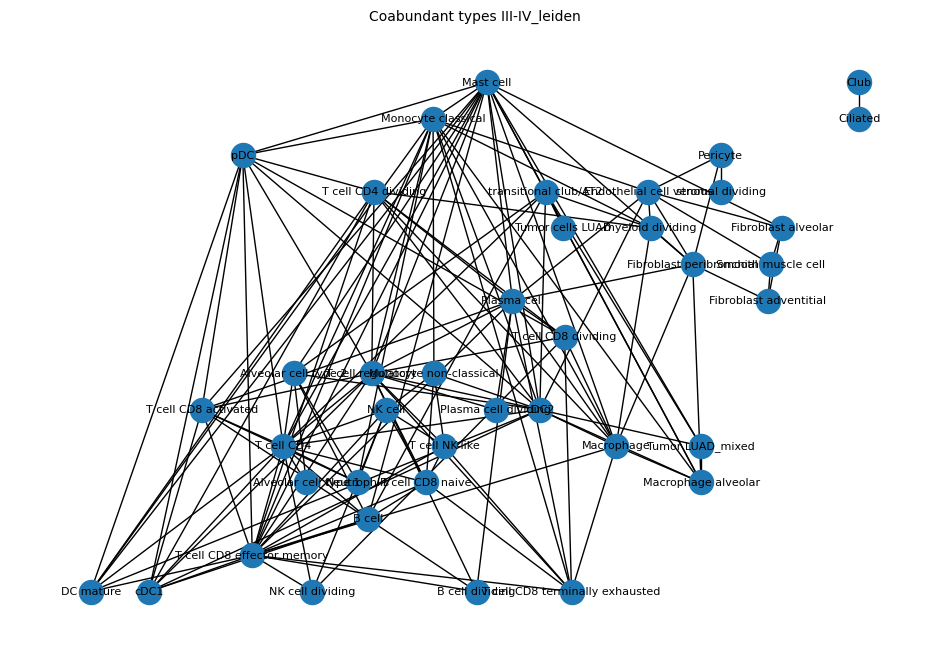

In [ ]:
plt.figure(figsize=(12, 8))  # Set a larger figure size (width, height in inches)
plt.title(f'Coabundant types {time}', fontsize=10)  # Smaller title font size

pos = graphviz_layout(G, prog="dot")
nx.draw(G, pos, with_labels=True, font_size=8)  # Smaller label font size
plt.savefig(f'{aracne_dir}/coabundant_types{time}.png')

In [ ]:
GII = G

### I-II Leiden no Zuani

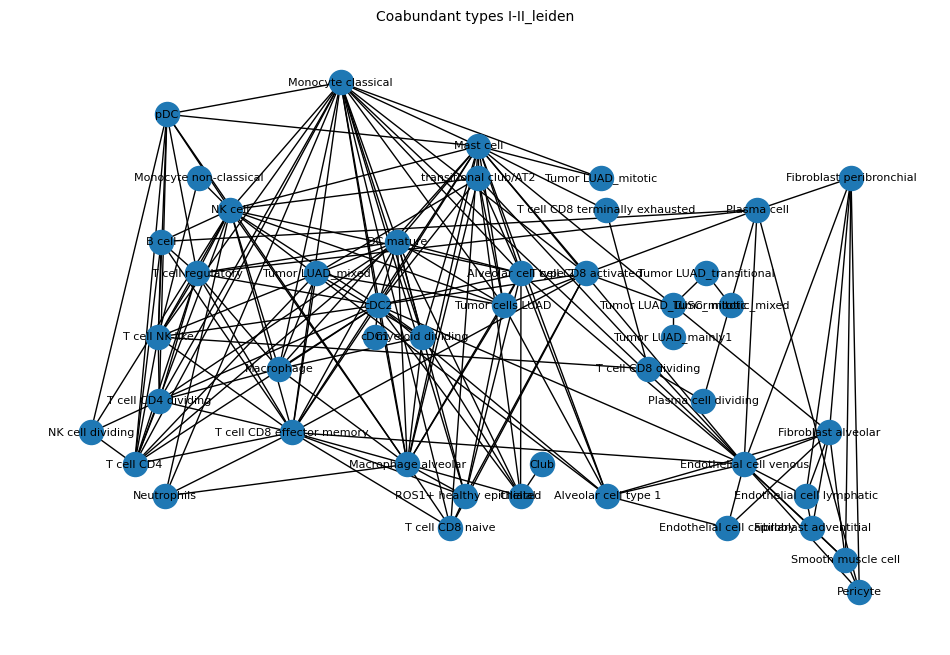

In [ ]:
plt.figure(figsize=(12, 8))  # Set a larger figure size (width, height in inches)
plt.title(f'Coabundant types {time}', fontsize=10)  # Smaller title font size

pos = graphviz_layout(G, prog="dot")
nx.draw(G, pos, with_labels=True, font_size=8)  # Smaller label font size
plt.savefig(f'{aracne_dir}/coabundant_types{time}.png')

### III-IV Zuani

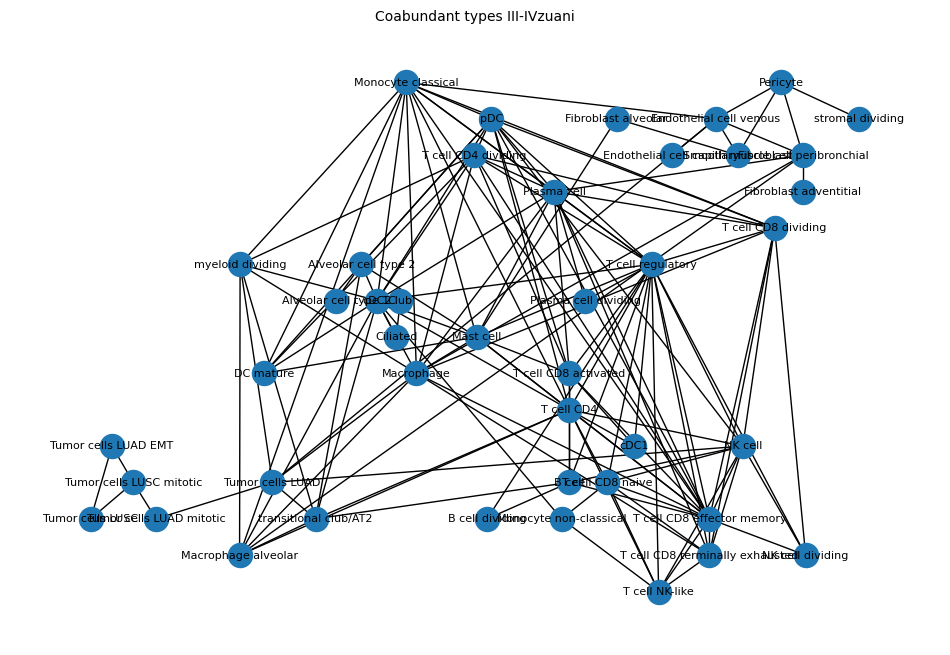

In [ ]:
plt.figure(figsize=(12, 8))  # Set a larger figure size (width, height in inches)
plt.title(f'Coabundant types {time}', fontsize=10)  # Smaller title font size

pos = graphviz_layout(G, prog="dot")
nx.draw(G, pos, with_labels=True, font_size=8)  # Smaller label font size
plt.savefig(f'{aracne_dir}/coabundant_types{time}.png')

In [ ]:
GI = G_I

Maybe we can do also mututal information of samples and see if clusters correlate with cancer or tissue type

## Functional Enrichment

To do a functional enrichment of the nodes in the network we can use the enrichment score from a GSEA run, on different hallmarks. For example the cancer Hallmarks.
To do this we can use the **NES**'s (normalized enrichment scores) for every study. 

This score is divided by the mean **ES** that would arise from all permutations of the gene set in question,
so as to be comparable with other gene sets. If it is $>1$ it is overexpressed, and if it is $<-1$ it is downregulated.

Due to the normalization we can do a mean of the **NES** in different studies to express a central notion of how expressed a gene set is.
We would also have to mind the FDR adjusted p-value to actually be on te sure side.

Let's procceed to massage the heatmap tables for our purposes.

In [ ]:
heatmap_dir = 'nb_tumorUMAP/gseapy_gsea'

# dsets = pd.read_csv('metadata/dsets.csv')
# dsets = dsets[lambda x: x['id'] != 'Zilionis_Klein_2019_NSCLC']
heatmaps = None
# for i, id_ in enumerate(dsets.id):
for i, region in enumerate(['tumorall', 'normalall']):
    # heatmap_path = f'{heatmap_dir}/heatmap_{id_}.csv'
    heatmap_path = f'{heatmap_dir}/heatmap_{region}_{time}.csv'
    heatmap = pd.read_csv(heatmap_path)
    heatmap['id'] = region
    heatmaps = pd.concat([heatmaps, heatmap]) if i != 0 else heatmap
# Pull the id column to the front
temp_cols=heatmaps.columns.tolist()
new_cols=temp_cols[-1:] + temp_cols[:-1]
heatmaps=heatmaps[new_cols]

# Function to extract and concatenate the 2nd and 4th elements after splitting
def concat_elements(s):
    parts = s.split('_')
    # Concatenate 2nd and 4th elements if they exist
    return parts[0] + '_' + parts[2] if len(parts) > 2 else None

# heatmaps['cell_type'] = heatmaps['cell_type'].apply(concat_elements)

heatmaps

Aggregate the means

In [ ]:
heatmaps = heatmaps.drop(columns=['id']).groupby('cell_type').mean()

Convert all entries with in interval [-1, 1] to `0`. And SUBSTRACT the 1, to only work with actually over and underexpressed values.

In [ ]:
start_ind = 1
filterer = (heatmaps.iloc[:, start_ind:] <= 1) & (heatmaps.iloc[:, start_ind:] >= -1)

# Convert the DataFrame to a numpy array for the assignment
heatmaps_array = heatmaps.to_numpy()

# Apply the mask to the relevant portion of the DataFrame's numpy array
# Note: np.nan is used here assuming numerical data; replace with None if applicable
heatmaps_array[:, start_ind:][filterer] = 0

# Substract 1 from valid values
filterer = heatmaps_array[:, start_ind:] > 1
heatmaps_array[:, start_ind:][filterer] -= 1

filterer = heatmaps_array[:, start_ind:] < -1
heatmaps_array[:, start_ind:][filterer] += 1

# Assign the modified array back to the DataFrame
heatmaps.iloc[:, :] = heatmaps_array
del heatmaps_array
heatmaps

Build the pie chart dict with the four most under and overexpressed functions for every type

In [ ]:
from itertools import islice

node_pie_over = {}
node_pie_under = {}

for type in heatmaps.index:
    dicter = heatmaps.loc[type, :].to_dict()
    
    sorted_dict = dict(sorted(dicter.items(), key=lambda item: item[1], reverse=True))
    sorted_dict = dict(islice(sorted_dict.items(), 4))
    
    # Only keep the functions that are not 0
    sorted_dict = {key:value for key, value in sorted_dict.items() if value != 0}

    if not sorted_dict:
        sorted_dict["NO OVEREXPRESSION"] = 1

    sorted_dict_under = dict(sorted(dicter.items(), key=lambda item: item[1], reverse=False))
    sorted_dict_under = dict(islice(sorted_dict_under.items(), 4))

    # Only keep the functions that are not 0
    sorted_dict_under = {key:value for key, value in sorted_dict_under.items() if value != 0}

    if not sorted_dict_under:
        sorted_dict_under["NO UNDEREXPRESSION"] = 1
        
    node_pie_over[type] = sorted_dict
    node_pie_under[type] = sorted_dict_under

node_pie_under

Get the counts for cells for every type:

In [ ]:
groups = pd.read_csv(f'metadata/groups{time}.csv')
groups = groups.set_index([cell_type_key, 'sample'])
num_cells = groups.groupby(cell_type_key).sum().to_dict()['0']

# num_cells = {key: np.log2(val) for key, val in num_cells.items()}
num_cells

{'Alveolar cell type 1': 278,
 'Alveolar cell type 2': 2155,
 'B cell': 14858,
 'B cell dividing': 80,
 'Ciliated': 1416,
 'Club': 280,
 'DC mature': 519,
 'Endothelial cell arterial': 142,
 'Endothelial cell capillary': 340,
 'Endothelial cell lymphatic': 191,
 'Endothelial cell venous': 1735,
 'Fibroblast adventitial': 333,
 'Fibroblast alveolar': 1024,
 'Fibroblast peribronchial': 1254,
 'Macrophage': 26859,
 'Macrophage alveolar': 12569,
 'Mast cell': 4710,
 'Mesothelial': 29,
 'Monocyte classical': 6132,
 'Monocyte non-classical': 576,
 'NK cell': 6400,
 'NK cell dividing': 146,
 'Neutrophils': 9518,
 'Pericyte': 312,
 'Plasma cell': 9849,
 'Plasma cell dividing': 213,
 'ROS1+ healthy epithelial': 15,
 'Smooth muscle cell': 310,
 'T cell CD4': 40540,
 'T cell CD4 dividing': 984,
 'T cell CD8 activated': 3108,
 'T cell CD8 dividing': 1117,
 'T cell CD8 effector memory': 16002,
 'T cell CD8 naive': 2720,
 'T cell CD8 terminally exhausted': 8314,
 'T cell NK-like': 3213,
 'T cell reg

Check the distribution of cells per type

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50],
 [Text(0, 0, 'Alveolar cell type 1'),
  Text(1, 0, 'Alveolar cell type 2'),
  Text(2, 0, 'B cell'),
  Text(3, 0, 'B cell dividing'),
  Text(4, 0, 'Ciliated'),
  Text(5, 0, 'Club'),
  Text(6, 0, 'DC mature'),
  Text(7, 0, 'Endothelial cell arterial'),
  Text(8, 0, 'Endothelial cell capillary'),
  Text(9, 0, 'Endothelial cell lymphatic'),
  Text(10, 0, 'Endothelial cell venous'),
  Text(11, 0, 'Fibroblast adventitial'),
  Text(12, 0, 'Fibroblast alveolar'),
  Text(13, 0, 'Fibroblast peribronchial'),
  Text(14, 0, 'Macrophage'),
  Text(15, 0, 'Macrophage alveolar'),
  Text(16, 0, 'Mast cell'),
  Text(17, 0, 'Mesothelial'),
  Text(18, 0, 'Monocyte classical'),
  Text(19, 0, 'Monocyte non-classical'

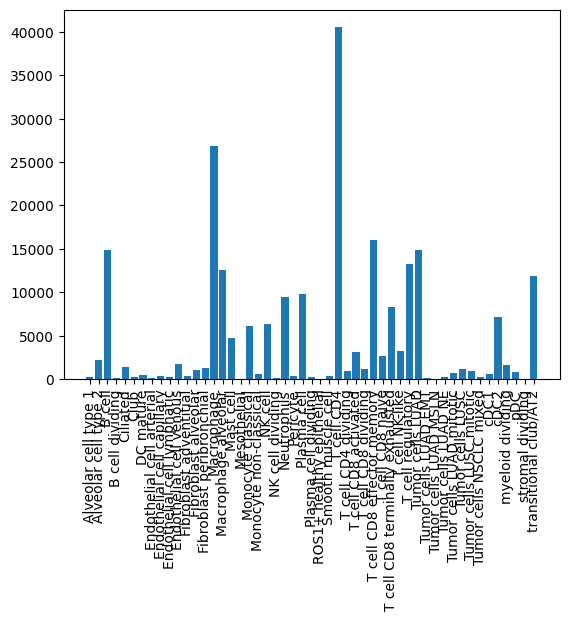

In [ ]:
plt.bar(num_cells.keys(), height=num_cells.values())
plt.xticks(rotation=90)

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50],
 [Text(0, 0, 'Alveolar cell type 1'),
  Text(1, 0, 'Alveolar cell type 2'),
  Text(2, 0, 'B cell'),
  Text(3, 0, 'B cell dividing'),
  Text(4, 0, 'Ciliated'),
  Text(5, 0, 'Club'),
  Text(6, 0, 'DC mature'),
  Text(7, 0, 'Endothelial cell arterial'),
  Text(8, 0, 'Endothelial cell capillary'),
  Text(9, 0, 'Endothelial cell lymphatic'),
  Text(10, 0, 'Endothelial cell venous'),
  Text(11, 0, 'Fibroblast adventitial'),
  Text(12, 0, 'Fibroblast alveolar'),
  Text(13, 0, 'Fibroblast peribronchial'),
  Text(14, 0, 'Macrophage'),
  Text(15, 0, 'Macrophage alveolar'),
  Text(16, 0, 'Mast cell'),
  Text(17, 0, 'Mesothelial'),
  Text(18, 0, 'Monocyte classical'),
  Text(19, 0, 'Monocyte non-classical'

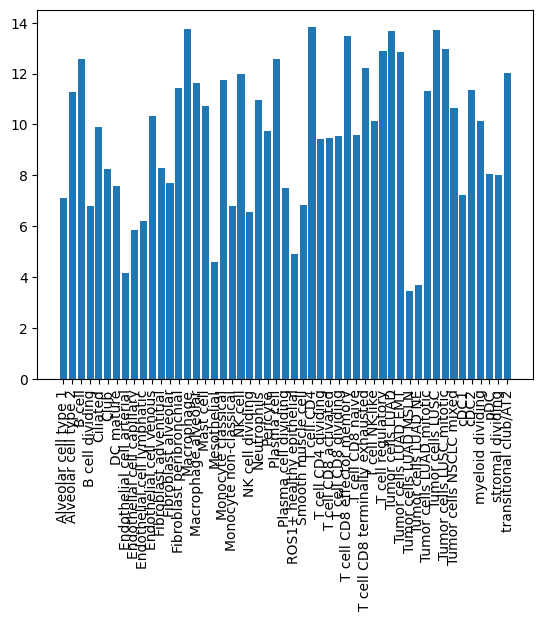

In [ ]:
plt.bar(num_cells.keys(), height=num_cells.values())
plt.xticks(rotation=90)

#### Overexpressed

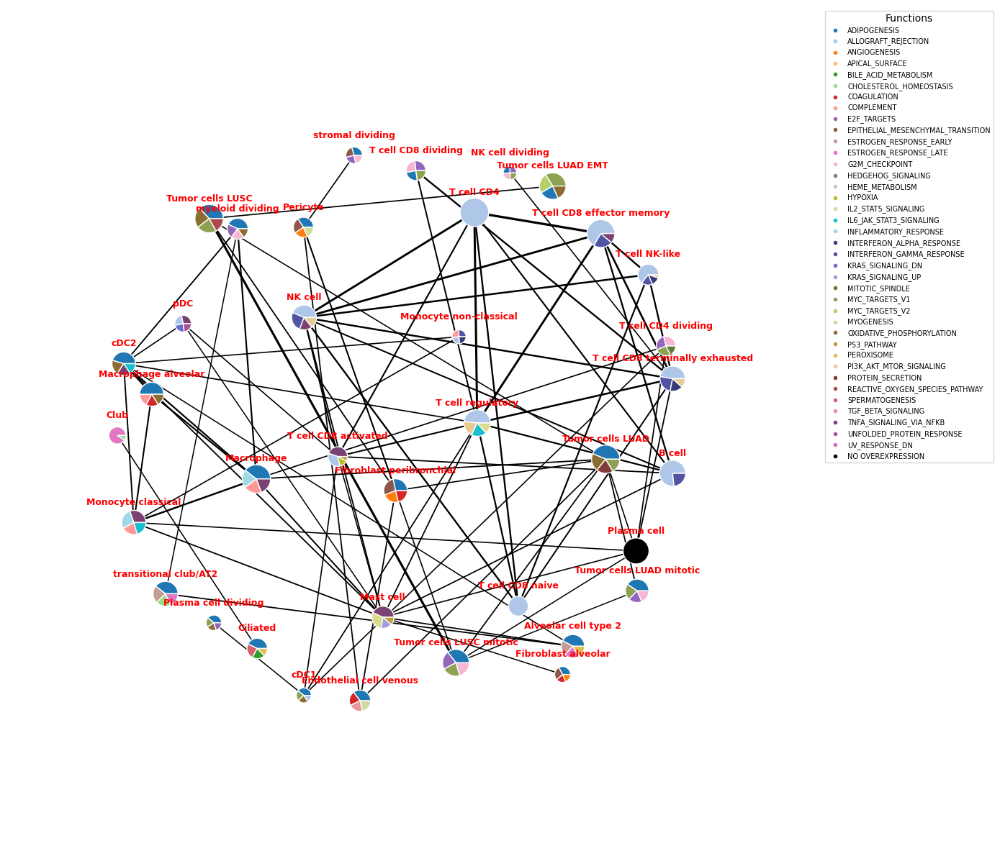

In [ ]:
fig, ax = ut.functional_network_plot(G, node_pie_over, num_cells=num_cells,
                                     figsize=(14, 12), spring_force=2, scale=1,
                                     max_radius=0.05, max_width=3, label_fontsize=9,
                                     show=False)
# fig = plt.gcf()
plt.tight_layout()
fig.savefig(f'{aracne_dir}/over_{id_}_{time}.png')
# plt.show()


#### Underexpressed

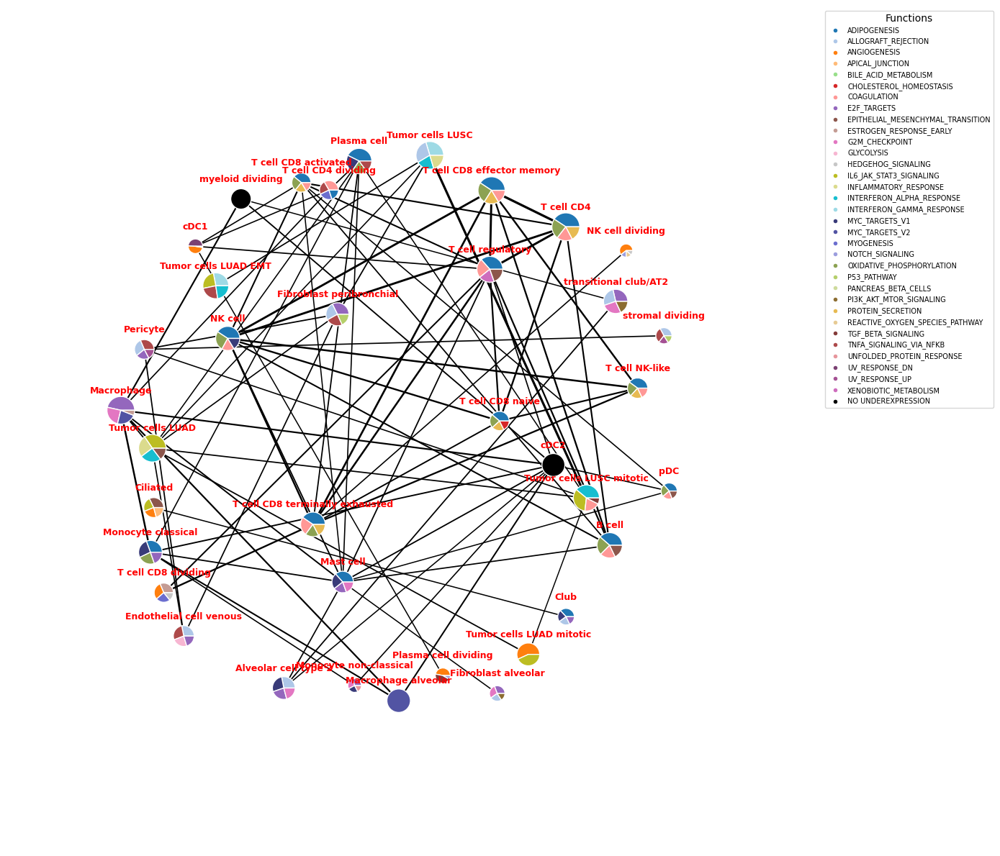

In [ ]:
ut.functional_network_plot(G, node_pie_under, num_cells=num_cells,
                             figsize=(14, 12), spring_force=2, scale=1,
                             max_radius=0.05, max_width=3, label_fontsize=9,
                             show=False)
plt.tight_layout()
fig.savefig(f'{aracne_dir}/under_{id_}_{time}.png')